Para os testes foi utilizado: (n_iter=500, step=0.0001, iterative=False)

In [1]:
import numpy as np
from CLog_MC_OvO import CLog_OVO
from CLog_MC_Ecoc import CLog_Ecoc
from utils import plot_decision_boundary
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from sklearn.datasets import load_digits, fetch_openml
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix

# Dataset Digits

In [2]:
#Load 
digits = load_digits()
X, y = digits.data, digits.target

#Normalizar
scaler = StandardScaler()
X = scaler.fit_transform(X)

# Dividir os dados em treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=4465)

# Eliminar e recodificar as classes

In [3]:
#Definir classes a remover
classes_remover = {0, 6, 7}
#Criar máscaras para filtrar
mask_train = ~np.isin(y_train, list(classes_remover))
mask_test = ~np.isin(y_test, list(classes_remover))

#Aplicar filtros
X_train_filtrado = X_train[mask_train]
y_train_filtrado = y_train[mask_train]
X_test_filtrado = X_test[mask_test]
y_test_filtrado = y_test[mask_test]

#Reindexar com LabelEncoder
le = LabelEncoder()
y_train_reindexed = le.fit_transform(y_train_filtrado)
y_test_reindexed = le.transform(y_test_filtrado)

mapa_original_para_novo = {orig: idx for idx, orig in enumerate(le.classes_)}
mapa_novo_para_original = {idx: orig for idx, orig in enumerate(le.classes_)}

labels_originais = le.classes_

print("Map original -> novo:")
for k, v in mapa_original_para_novo.items():
    print(f"Classe original {k} -> nova {v}")

Map original -> novo:
Classe original 1 -> nova 0
Classe original 2 -> nova 1
Classe original 3 -> nova 2
Classe original 4 -> nova 3
Classe original 5 -> nova 4
Classe original 8 -> nova 5
Classe original 9 -> nova 6


# OvO Primal, Kernel 1, MGB, 1000

Training binary classifiers: 100%|██████████| 21/21 [00:00<00:00, 24.85it/s, Par=5 vs 6]


Accuracy de treino: 0.20
Accuracy de Teste: 0.18


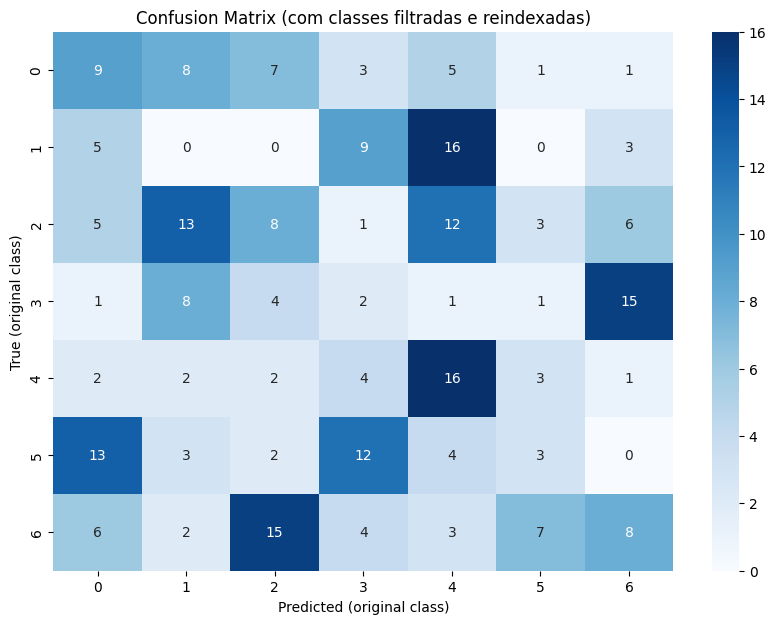

In [4]:
clf = CLog_OVO(n_iter=500, batch_size=None, kernel=1, step=0.0001, mode='primal', iterative=False)
clf.fit(X_train_filtrado, y_train_reindexed)

y_pred_train = clf.predict(X_train_filtrado)
acc_train = accuracy_score(y_train_reindexed, y_pred_train)
print(f"Accuracy de treino: {acc_train:.2f}")

y_pred_test = clf.predict(X_test_filtrado)
accuracy = accuracy_score(y_test_reindexed, y_pred_test)
print(f"Accuracy de Teste: {accuracy:.2f}")

#Matriz de confusão com rótulos originais
cm = confusion_matrix(y_test_reindexed, y_pred_test)

#Mapping das classes de volta para os rótulos originais
xticks_labels = [str(classe) for classe in clf.classes_]
yticks_labels = [str(classe) for classe in clf.classes_]

plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=xticks_labels, yticklabels=yticks_labels)
plt.xlabel('Predicted (original class)')
plt.ylabel('True (original class)')
plt.title('Confusion Matrix (com classes filtradas e reindexadas)')
plt.show()


# OvO Primal, Kernel 1, MGmB, 1000

Training binary classifiers: 100%|██████████| 21/21 [00:00<00:00, 30.72it/s, Par=5 vs 6]


Accuracy de treino: 0.19
Accuracy de Teste: 0.17


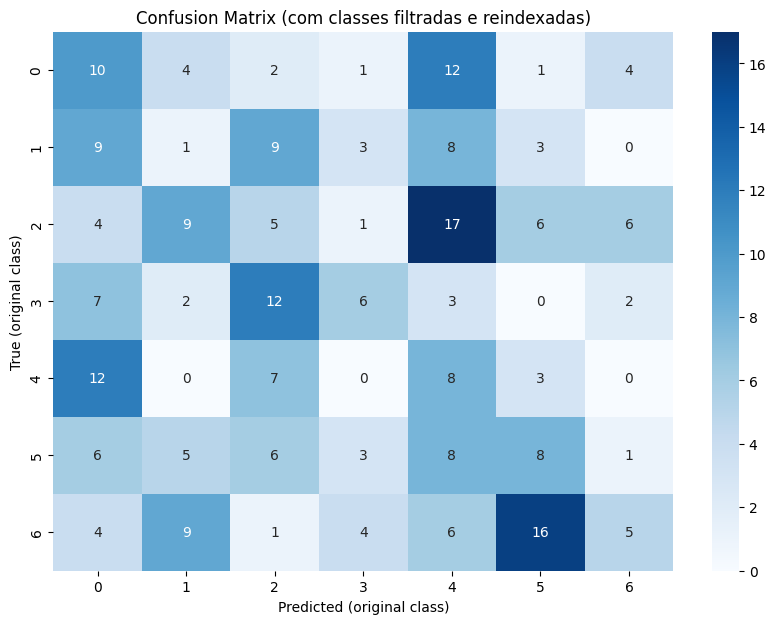

In [5]:
clf = CLog_OVO(n_iter=500, batch_size=64, kernel=1, step=0.0001, mode='primal', iterative=False)
clf.fit(X_train_filtrado, y_train_reindexed)

y_pred_train = clf.predict(X_train_filtrado)
acc_train = accuracy_score(y_train_reindexed, y_pred_train)
print(f"Accuracy de treino: {acc_train:.2f}")

y_pred_test = clf.predict(X_test_filtrado)
accuracy = accuracy_score(y_test_reindexed, y_pred_test)
print(f"Accuracy de Teste: {accuracy:.2f}")

#Matriz de confusão com rótulos originais
cm = confusion_matrix(y_test_reindexed, y_pred_test)

#Mapping das classes de volta para os rótulos originais
xticks_labels = [str(classe) for classe in clf.classes_]
yticks_labels = [str(classe) for classe in clf.classes_]

plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=xticks_labels, yticklabels=yticks_labels)
plt.xlabel('Predicted (original class)')
plt.ylabel('True (original class)')
plt.title('Confusion Matrix (com classes filtradas e reindexadas)')
plt.show()


# OvO Primal, Kernel 1, MGE, 1000

Training binary classifiers: 100%|██████████| 21/21 [00:00<00:00, 38.61it/s, Par=5 vs 6]


Accuracy de treino: 0.11
Accuracy de Teste: 0.05


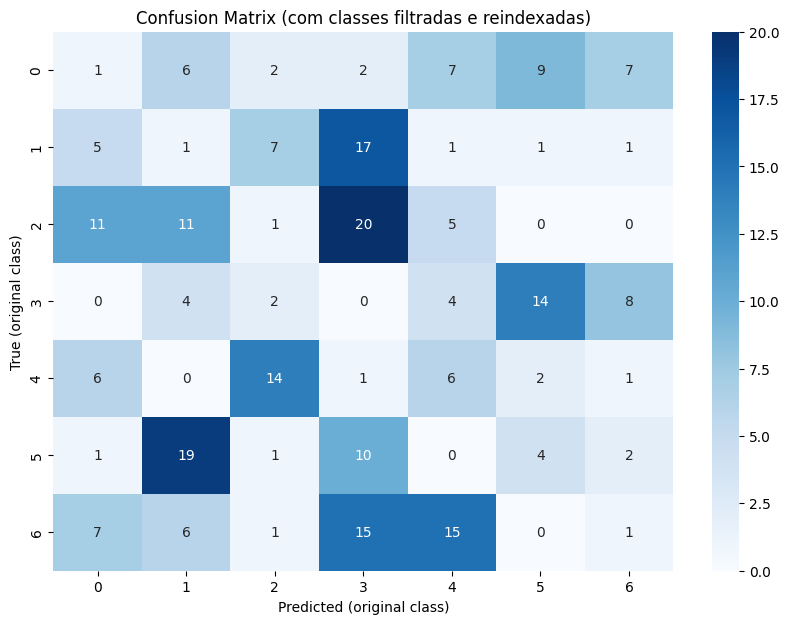

In [6]:
clf = CLog_OVO(n_iter=500, batch_size=1, kernel=1, step=0.0001, mode='primal', iterative=False)
clf.fit(X_train_filtrado, y_train_reindexed)

y_pred_train = clf.predict(X_train_filtrado)
acc_train = accuracy_score(y_train_reindexed, y_pred_train)
print(f"Accuracy de treino: {acc_train:.2f}")

y_pred_test = clf.predict(X_test_filtrado)
accuracy = accuracy_score(y_test_reindexed, y_pred_test)
print(f"Accuracy de Teste: {accuracy:.2f}")

#Matriz de confusão com rótulos originais
cm = confusion_matrix(y_test_reindexed, y_pred_test)

#Mapping das classes de volta para os rótulos originais
xticks_labels = [str(classe) for classe in clf.classes_]
yticks_labels = [str(classe) for classe in clf.classes_]

plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=xticks_labels, yticklabels=yticks_labels)
plt.xlabel('Predicted (original class)')
plt.ylabel('True (original class)')
plt.title('Confusion Matrix (com classes filtradas e reindexadas)')
plt.show()


# OvO Dual, Kernel 1, MGB, 1000

Training binary classifiers: 100%|██████████| 21/21 [00:01<00:00, 16.23it/s, Par=5 vs 6]


Accuracy de treino: 0.98
Accuracy de Teste: 0.94


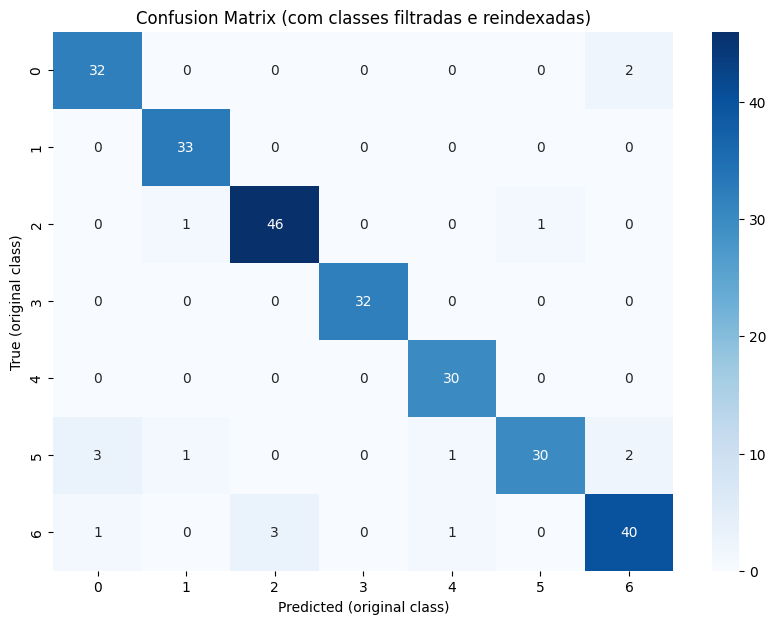

In [7]:
clf = CLog_OVO(n_iter=500, batch_size=None, kernel=1, step=0.0001, mode='dual', iterative=False)
clf.fit(X_train_filtrado, y_train_reindexed)

y_pred_train = clf.predict(X_train_filtrado)
acc_train = accuracy_score(y_train_reindexed, y_pred_train)
print(f"Accuracy de treino: {acc_train:.2f}")

y_pred_test = clf.predict(X_test_filtrado)
accuracy = accuracy_score(y_test_reindexed, y_pred_test)
print(f"Accuracy de Teste: {accuracy:.2f}")

#Matriz de confusão com rótulos originais
cm = confusion_matrix(y_test_reindexed, y_pred_test)

#Mapping das classes de volta para os rótulos originais
xticks_labels = [str(classe) for classe in clf.classes_]
yticks_labels = [str(classe) for classe in clf.classes_]

plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=xticks_labels, yticklabels=yticks_labels)
plt.xlabel('Predicted (original class)')
plt.ylabel('True (original class)')
plt.title('Confusion Matrix (com classes filtradas e reindexadas)')
plt.show()


# OvO Dual, Kernel 1, MGmB, 1000

Training binary classifiers: 100%|██████████| 21/21 [00:00<00:00, 25.78it/s, Par=5 vs 6]


Accuracy de treino: 0.98
Accuracy de Teste: 0.94


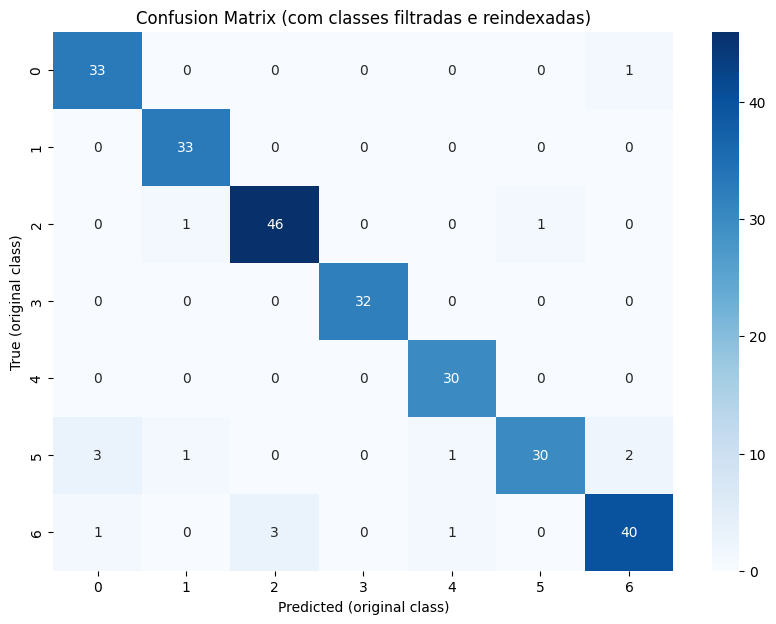

In [8]:
clf = CLog_OVO(n_iter=500, batch_size=64, kernel=1, step=0.0001, mode='dual', iterative=False)
clf.fit(X_train_filtrado, y_train_reindexed)

y_pred_train = clf.predict(X_train_filtrado)
acc_train = accuracy_score(y_train_reindexed, y_pred_train)
print(f"Accuracy de treino: {acc_train:.2f}")

y_pred_test = clf.predict(X_test_filtrado)
accuracy = accuracy_score(y_test_reindexed, y_pred_test)
print(f"Accuracy de Teste: {accuracy:.2f}")

#Matriz de confusão com rótulos originais
cm = confusion_matrix(y_test_reindexed, y_pred_test)

#Mapping das classes de volta para os rótulos originais
xticks_labels = [str(classe) for classe in clf.classes_]
yticks_labels = [str(classe) for classe in clf.classes_]

plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=xticks_labels, yticklabels=yticks_labels)
plt.xlabel('Predicted (original class)')
plt.ylabel('True (original class)')
plt.title('Confusion Matrix (com classes filtradas e reindexadas)')
plt.show()


# OvO Dual, Kernel 1, MGE, 1000

Training binary classifiers: 100%|██████████| 21/21 [00:00<00:00, 36.38it/s, Par=5 vs 6]


Accuracy de treino: 0.93
Accuracy de Teste: 0.92


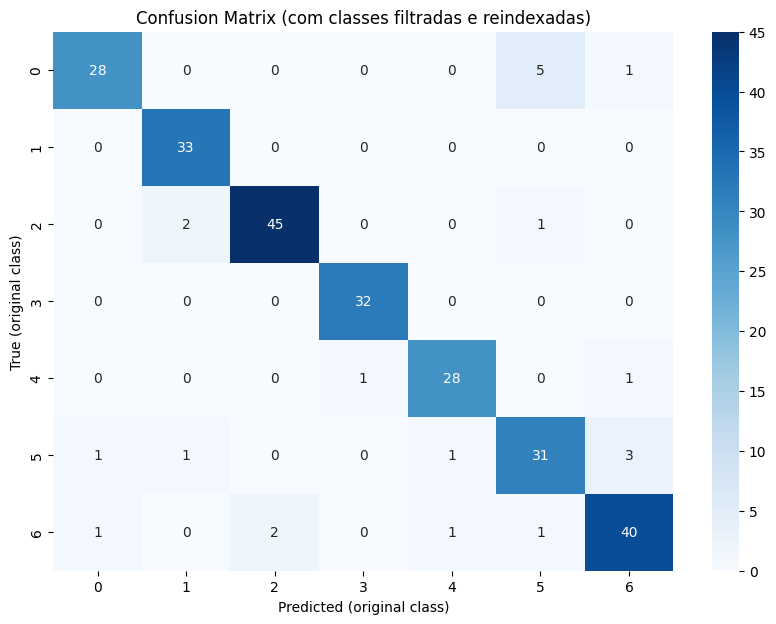

In [9]:
clf = CLog_OVO(n_iter=500, batch_size=1, kernel=1, step=0.0001, mode='dual', iterative=False)
clf.fit(X_train_filtrado, y_train_reindexed)

y_pred_train = clf.predict(X_train_filtrado)
acc_train = accuracy_score(y_train_reindexed, y_pred_train)
print(f"Accuracy de treino: {acc_train:.2f}")

y_pred_test = clf.predict(X_test_filtrado)
accuracy = accuracy_score(y_test_reindexed, y_pred_test)
print(f"Accuracy de Teste: {accuracy:.2f}")

#Matriz de confusão com rótulos originais
cm = confusion_matrix(y_test_reindexed, y_pred_test)

#Mapping das classes de volta para os rótulos originais
xticks_labels = [str(classe) for classe in clf.classes_]
yticks_labels = [str(classe) for classe in clf.classes_]

plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=xticks_labels, yticklabels=yticks_labels)
plt.xlabel('Predicted (original class)')
plt.ylabel('True (original class)')
plt.title('Confusion Matrix (com classes filtradas e reindexadas)')
plt.show()


# OvO Dual, Kernel 2, MGB, 1000

Training binary classifiers:   0%|          | 0/21 [00:00<?, ?it/s]c:\Users\conta\Desktop\Stuff\Universidade\OML\Projeto-OML\CLogDKPd_MGmB.py:40: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-x))
Training binary classifiers: 100%|██████████| 21/21 [00:01<00:00, 14.87it/s, Par=5 vs 6]
c:\Users\conta\Desktop\Stuff\Universidade\OML\Projeto-OML\CLogDKPd_MGmB.py:40: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-x))


Accuracy de treino: 1.00
Accuracy de Teste: 0.90


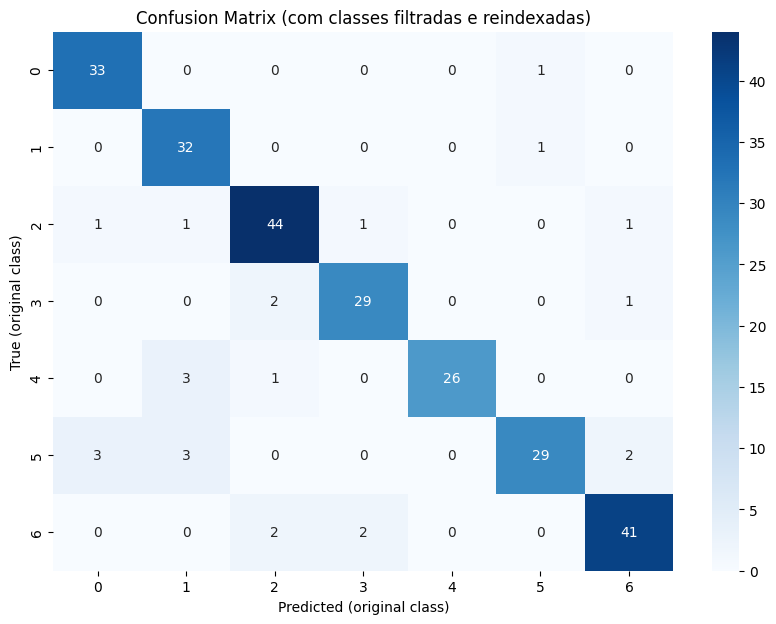

In [10]:
clf = CLog_OVO(n_iter=500, batch_size=None, kernel=2, step=0.0001, mode='dual', iterative=False)
clf.fit(X_train_filtrado, y_train_reindexed)

y_pred_train = clf.predict(X_train_filtrado)
acc_train = accuracy_score(y_train_reindexed, y_pred_train)
print(f"Accuracy de treino: {acc_train:.2f}")

y_pred_test = clf.predict(X_test_filtrado)
accuracy = accuracy_score(y_test_reindexed, y_pred_test)
print(f"Accuracy de Teste: {accuracy:.2f}")

#Matriz de confusão com rótulos originais
cm = confusion_matrix(y_test_reindexed, y_pred_test)

#Mapping das classes de volta para os rótulos originais
xticks_labels = [str(classe) for classe in clf.classes_]
yticks_labels = [str(classe) for classe in clf.classes_]

plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=xticks_labels, yticklabels=yticks_labels)
plt.xlabel('Predicted (original class)')
plt.ylabel('True (original class)')
plt.title('Confusion Matrix (com classes filtradas e reindexadas)')
plt.show()


# OvO Dual, Kernel 2, MGmB, 1000

Training binary classifiers:   0%|          | 0/21 [00:00<?, ?it/s]c:\Users\conta\Desktop\Stuff\Universidade\OML\Projeto-OML\CLogDKPd_MGmB.py:40: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-x))
Training binary classifiers: 100%|██████████| 21/21 [00:00<00:00, 274.61it/s, Par=5 vs 6]
c:\Users\conta\Desktop\Stuff\Universidade\OML\Projeto-OML\CLogDKPd_MGmB.py:40: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-x))


Accuracy de treino: 0.91
Accuracy de Teste: 0.84


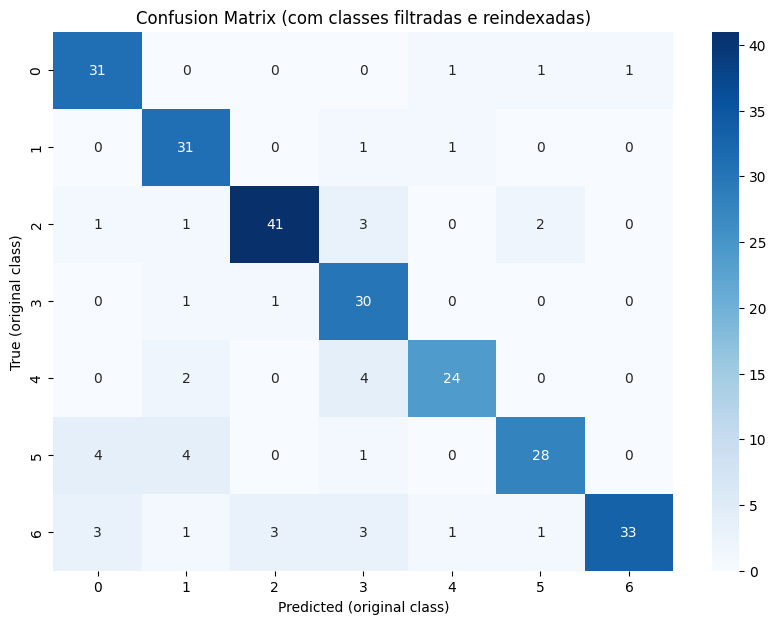

In [11]:
clf = CLog_OVO(n_iter=500, batch_size=64, kernel=2, step=0.0001, mode='dual', iterative=False)
clf.fit(X_train_filtrado, y_train_reindexed)

y_pred_train = clf.predict(X_train_filtrado)
acc_train = accuracy_score(y_train_reindexed, y_pred_train)
print(f"Accuracy de treino: {acc_train:.2f}")

y_pred_test = clf.predict(X_test_filtrado)
accuracy = accuracy_score(y_test_reindexed, y_pred_test)
print(f"Accuracy de Teste: {accuracy:.2f}")

#Matriz de confusão com rótulos originais
cm = confusion_matrix(y_test_reindexed, y_pred_test)

#Mapping das classes de volta para os rótulos originais
xticks_labels = [str(classe) for classe in clf.classes_]
yticks_labels = [str(classe) for classe in clf.classes_]

plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=xticks_labels, yticklabels=yticks_labels)
plt.xlabel('Predicted (original class)')
plt.ylabel('True (original class)')
plt.title('Confusion Matrix (com classes filtradas e reindexadas)')
plt.show()


# OvO Dual, Kernel 2, MGE, 1000

Training binary classifiers:   0%|          | 0/21 [00:00<?, ?it/s]c:\Users\conta\Desktop\Stuff\Universidade\OML\Projeto-OML\CLogDKPd_MGmB.py:40: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-x))
Training binary classifiers: 100%|██████████| 21/21 [00:00<00:00, 36.36it/s, Par=5 vs 6]
c:\Users\conta\Desktop\Stuff\Universidade\OML\Projeto-OML\CLogDKPd_MGmB.py:40: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-x))


Accuracy de treino: 0.84
Accuracy de Teste: 0.78


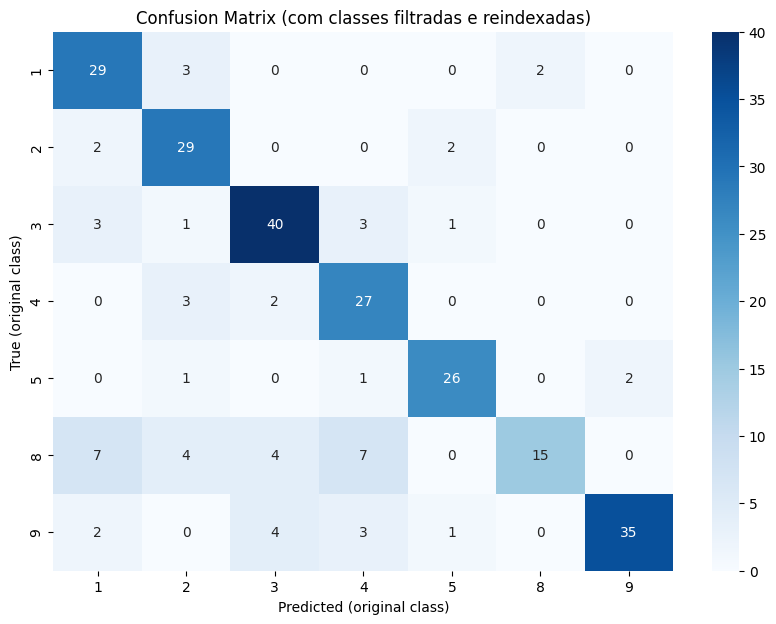

In [ ]:
clf = CLog_OVO(n_iter=500, batch_size=1, kernel=2, step=0.0001, mode='dual', iterative=False)
clf.fit(X_train_filtrado, y_train_reindexed)

y_pred_train = clf.predict(X_train_filtrado)
acc_train = accuracy_score(y_train_reindexed, y_pred_train)
print(f"Accuracy de treino: {acc_train:.2f}")

y_pred_test = clf.predict(X_test_filtrado)
accuracy = accuracy_score(y_test_reindexed, y_pred_test)
print(f"Accuracy de Teste: {accuracy:.2f}")

#Matriz de confusão com rótulos originais
cm = confusion_matrix(y_test_reindexed, y_pred_test)

#Mapping das classes de volta para os rótulos originais
xticks_labels = [str(classe) for classe in clf.classes_]
yticks_labels = [str(classe) for classe in clf.classes_]
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=xticks_labels, yticklabels=yticks_labels)
plt.xlabel('Predicted (original class)')
plt.ylabel('True (original class)')
plt.title('Confusion Matrix (com classes filtradas e reindexadas)')
plt.show()


# Ecoc Primal, Kernel 1, MGB, 1000

Será gerado output codes de tamanho 63 bits para dados com 7 classes diferentes e canônicas.
Gerando modelo para bit #1 do output code...
Gerando modelo para bit #2 do output code...
Gerando modelo para bit #3 do output code...
Gerando modelo para bit #4 do output code...
Gerando modelo para bit #5 do output code...
Gerando modelo para bit #6 do output code...
Gerando modelo para bit #7 do output code...
Gerando modelo para bit #8 do output code...
Gerando modelo para bit #9 do output code...
Gerando modelo para bit #10 do output code...
Gerando modelo para bit #11 do output code...
Gerando modelo para bit #12 do output code...
Gerando modelo para bit #13 do output code...
Gerando modelo para bit #14 do output code...
Gerando modelo para bit #15 do output code...
Gerando modelo para bit #16 do output code...
Gerando modelo para bit #17 do output code...
Gerando modelo para bit #18 do output code...
Gerando modelo para bit #19 do output code...
Gerando modelo para bit #20 do output code

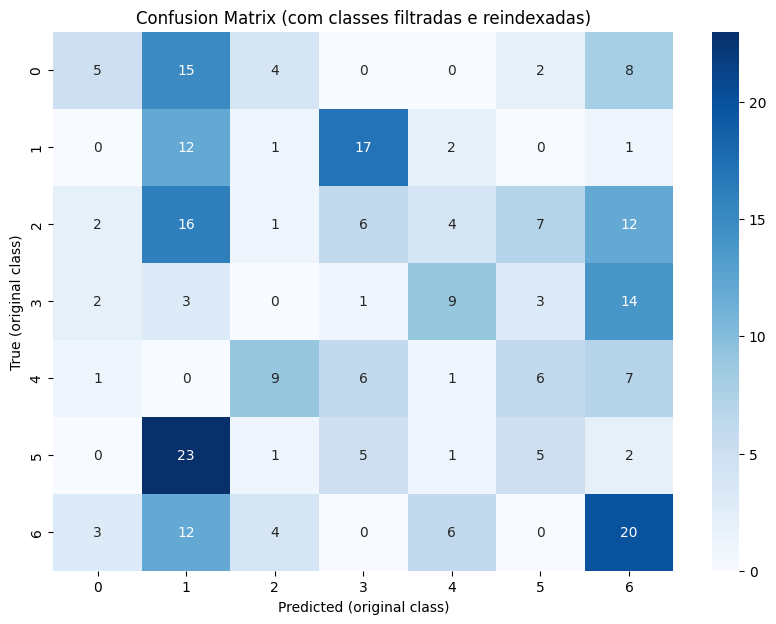

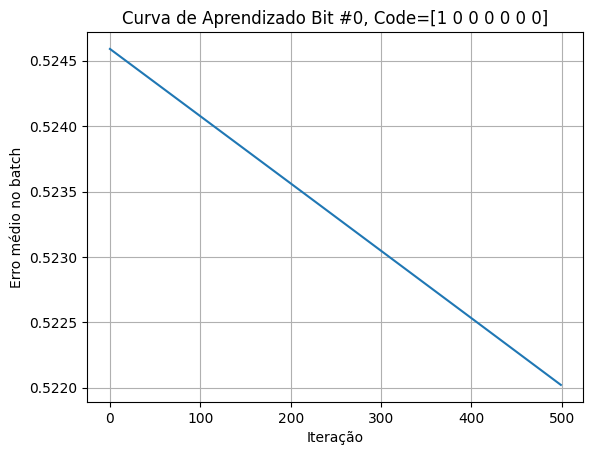

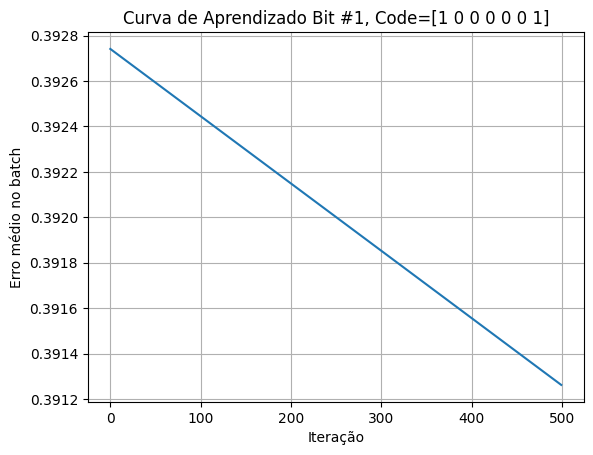

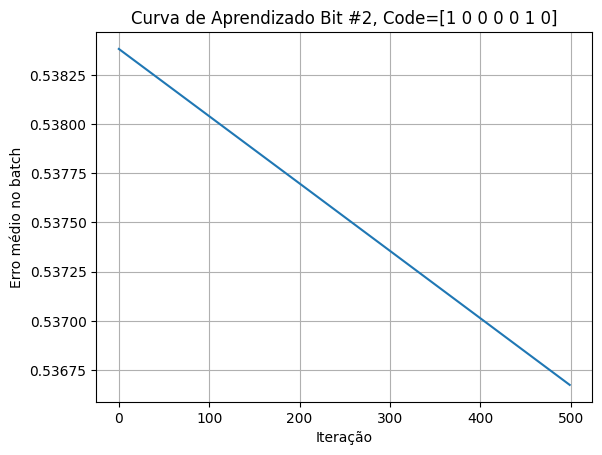

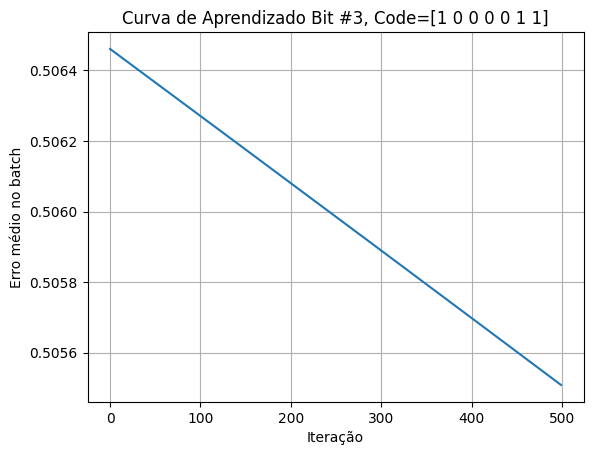

...

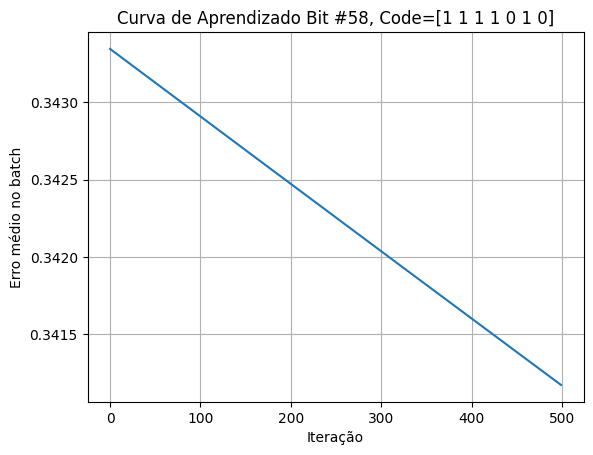

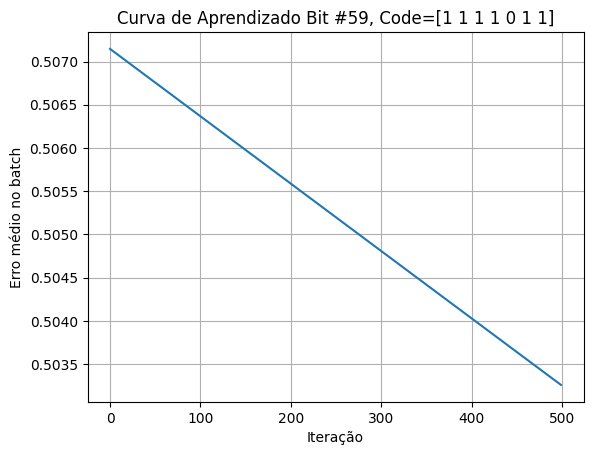

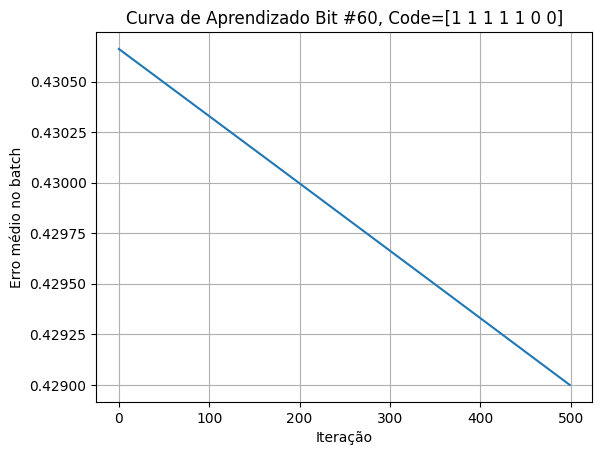

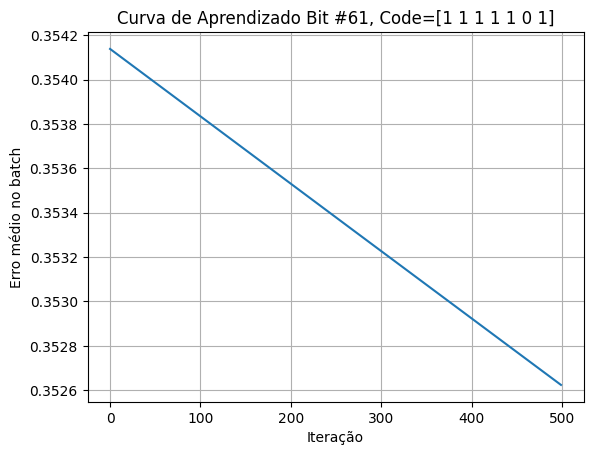

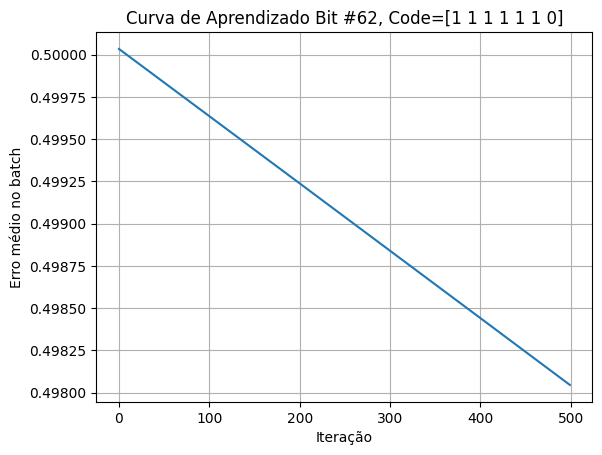

In [13]:
model = CLog_Ecoc(kernel=1, step=0.0001, n_iter=500, batch_size=None, iterative=False, mode='primal')

model.fit(X_train_filtrado, y_train_reindexed)

y_pred_train = model.predict(X_train_filtrado)
acc_train = accuracy_score(y_train_reindexed, y_pred_train)
print(f"Accuracy de treino: {acc_train:.2f}")

y_pred_test = model.predict(X_test_filtrado)
acc_test = accuracy_score(y_test_reindexed, y_pred_test)
print(f"Accuracy de teste: {acc_test:.2f}")

#Matriz de confusão com rótulos originais
cm = confusion_matrix(y_test_reindexed, y_pred_test)

#Mapping das classes de volta para os rótulos originais
xticks_labels = [str(classe) for classe in model.classes_]
yticks_labels = [str(classe) for classe in model.classes_]

plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=xticks_labels, yticklabels=yticks_labels)
plt.xlabel('Predicted (original class)')
plt.ylabel('True (original class)')
plt.title('Confusion Matrix (com classes filtradas e reindexadas)')
plt.show()


# === Curvas de aprendizagem ===
for i, errors in enumerate(model.get_errors()):
    plt.figure()
    plt.plot(errors)
    plt.title(f"Curva de Aprendizado Bit #{i}, Code={model.codes[:, i]}")
    plt.xlabel("Iteração")
    plt.ylabel("Erro médio no batch")
    plt.grid(True)
    plt.show()

# Ecoc Primal, Kernel 1, MGMB, 1000

Será gerado output codes de tamanho 63 bits para dados com 7 classes diferentes e canônicas.
Gerando modelo para bit #1 do output code...
Gerando modelo para bit #2 do output code...
Gerando modelo para bit #3 do output code...
Gerando modelo para bit #4 do output code...
Gerando modelo para bit #5 do output code...
Gerando modelo para bit #6 do output code...
Gerando modelo para bit #7 do output code...
Gerando modelo para bit #8 do output code...
Gerando modelo para bit #9 do output code...
Gerando modelo para bit #10 do output code...
Gerando modelo para bit #11 do output code...
Gerando modelo para bit #12 do output code...
Gerando modelo para bit #13 do output code...
Gerando modelo para bit #14 do output code...
Gerando modelo para bit #15 do output code...
Gerando modelo para bit #16 do output code...
Gerando modelo para bit #17 do output code...
Gerando modelo para bit #18 do output code...
Gerando modelo para bit #19 do output code...
Gerando modelo para bit #20 do output code

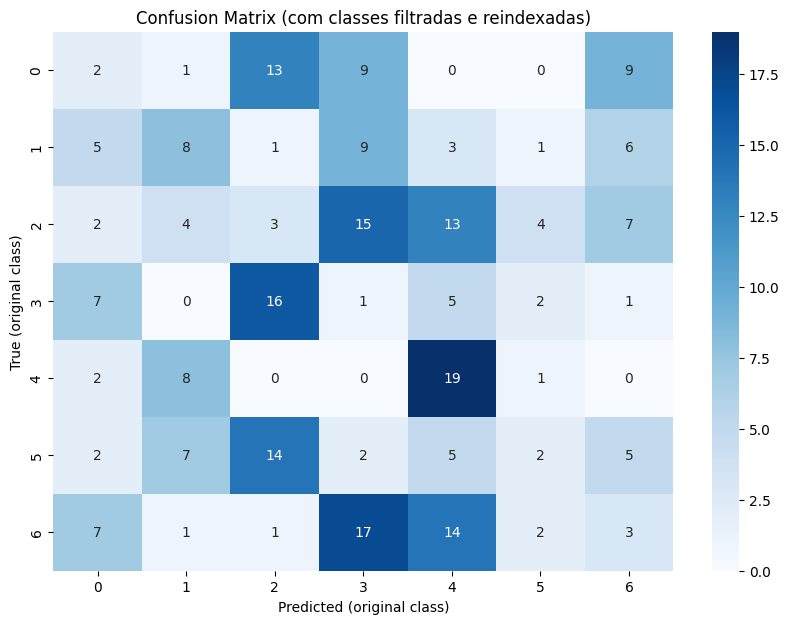

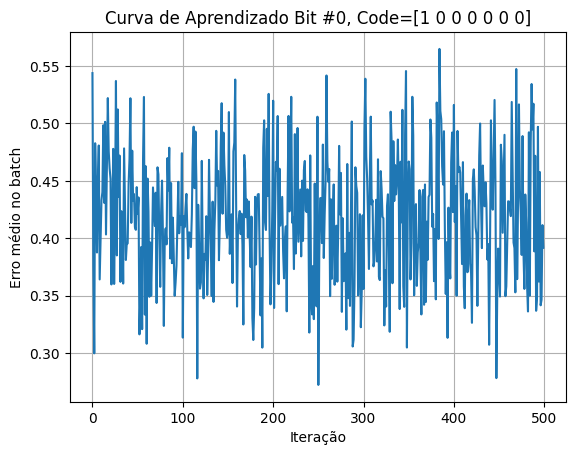

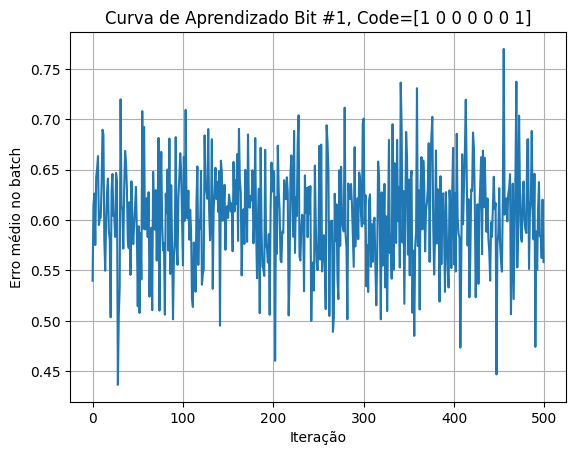

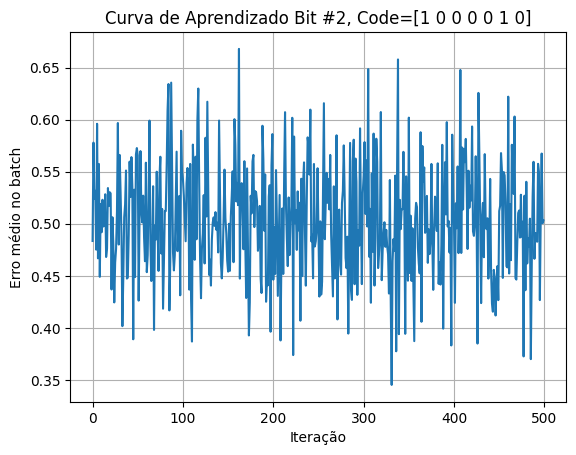

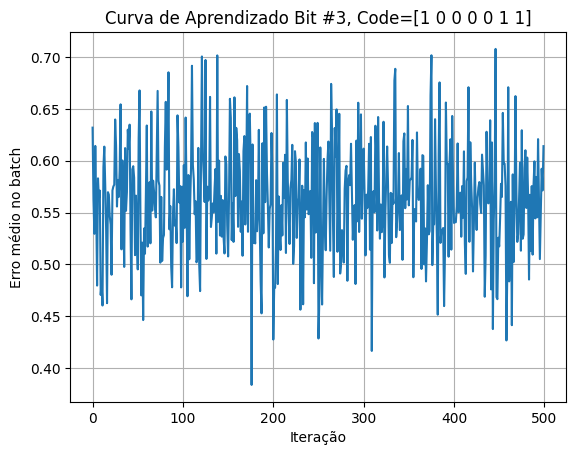

...

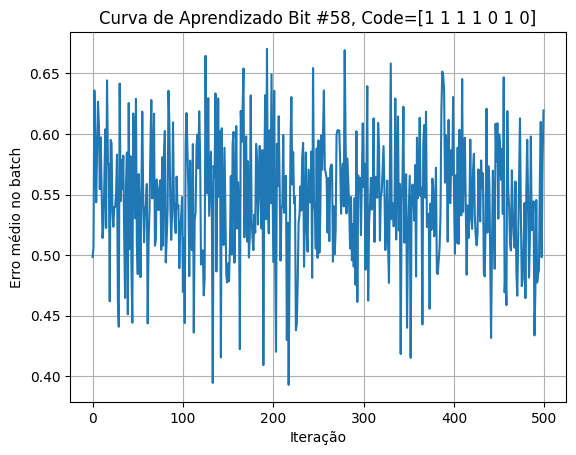

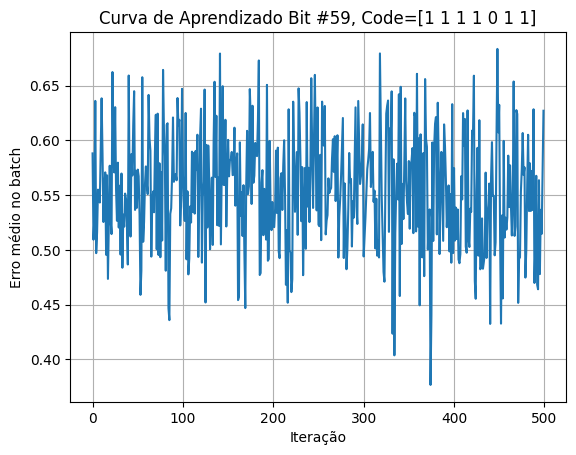

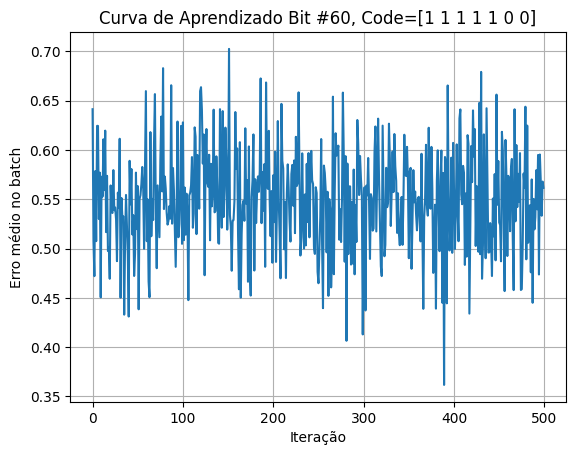

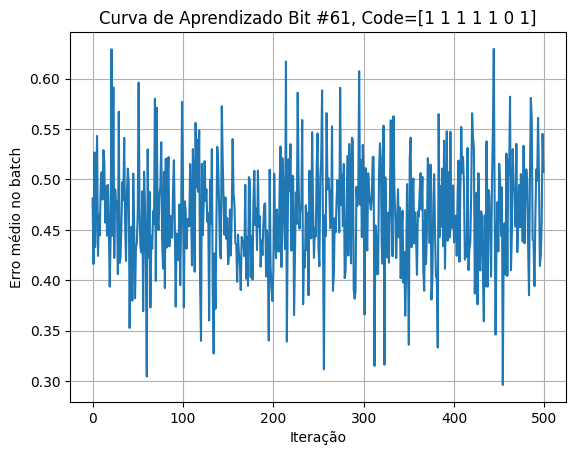

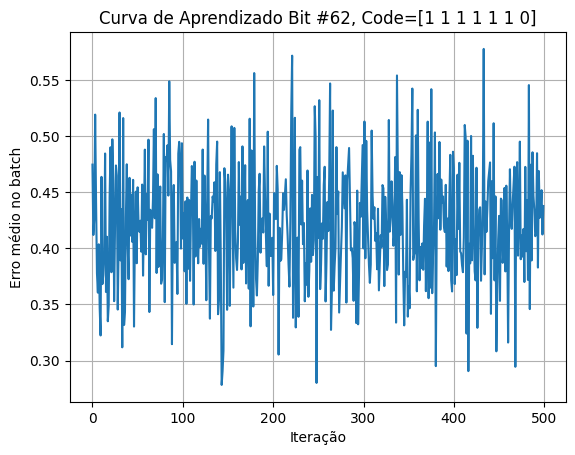

In [14]:
model = CLog_Ecoc(kernel=1, step=0.0001, n_iter=500, batch_size=64, iterative=False, mode='primal')

model.fit(X_train_filtrado, y_train_reindexed)

y_pred_train = model.predict(X_train_filtrado)
acc_train = accuracy_score(y_train_reindexed, y_pred_train)
print(f"Accuracy de treino: {acc_train:.2f}")

y_pred_test = model.predict(X_test_filtrado)
acc_test = accuracy_score(y_test_reindexed, y_pred_test)
print(f"Accuracy de teste: {acc_test:.2f}")

#Matriz de confusão com rótulos originais
cm = confusion_matrix(y_test_reindexed, y_pred_test)

#Mapping das classes de volta para os rótulos originais
xticks_labels = [str(classe) for classe in model.classes_]
yticks_labels = [str(classe) for classe in model.classes_]
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=xticks_labels, yticklabels=yticks_labels)
plt.xlabel('Predicted (original class)')
plt.ylabel('True (original class)')
plt.title('Confusion Matrix (com classes filtradas e reindexadas)')
plt.show()

# === Curvas de aprendizagem ===
for i, errors in enumerate(model.get_errors()):
    plt.figure()
    plt.plot(errors)
    plt.title(f"Curva de Aprendizado Bit #{i}, Code={model.codes[:, i]}")
    plt.xlabel("Iteração")
    plt.ylabel("Erro médio no batch")
    plt.grid(True)
    plt.show()

    

# Ecoc Primal, Kernel 1, MGE, 1000

Será gerado output codes de tamanho 63 bits para dados com 7 classes diferentes e canônicas.
Gerando modelo para bit #1 do output code...
Gerando modelo para bit #2 do output code...
Gerando modelo para bit #3 do output code...
Gerando modelo para bit #4 do output code...
Gerando modelo para bit #5 do output code...
Gerando modelo para bit #6 do output code...
Gerando modelo para bit #7 do output code...
Gerando modelo para bit #8 do output code...
Gerando modelo para bit #9 do output code...
Gerando modelo para bit #10 do output code...
Gerando modelo para bit #11 do output code...
Gerando modelo para bit #12 do output code...
Gerando modelo para bit #13 do output code...
Gerando modelo para bit #14 do output code...
Gerando modelo para bit #15 do output code...
Gerando modelo para bit #16 do output code...
Gerando modelo para bit #17 do output code...
Gerando modelo para bit #18 do output code...
Gerando modelo para bit #19 do output code...
Gerando modelo para bit #20 do output code

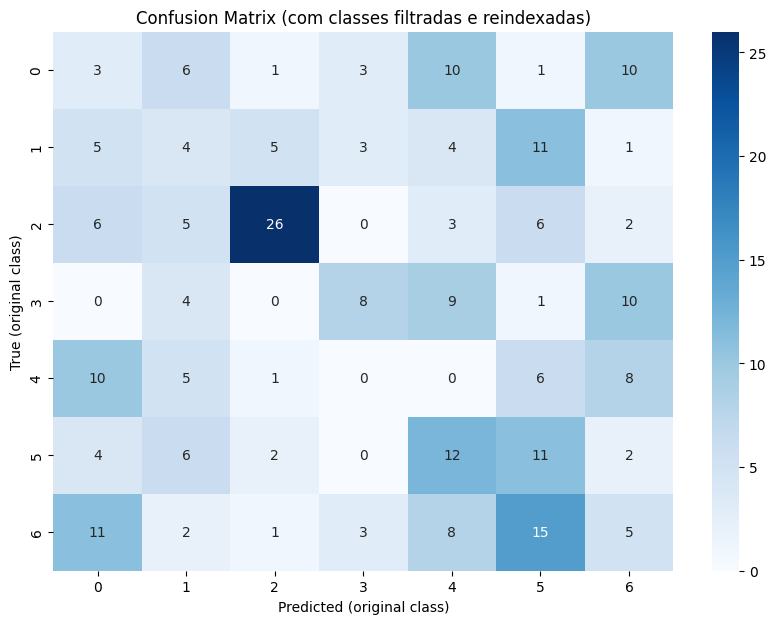

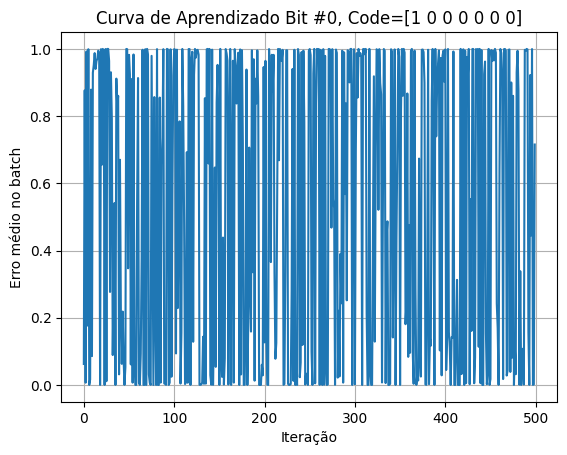

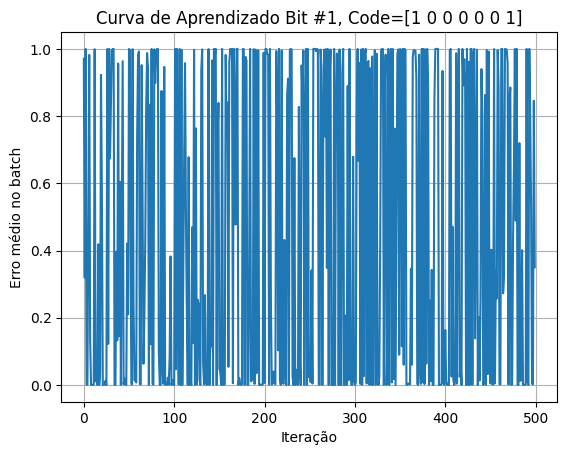

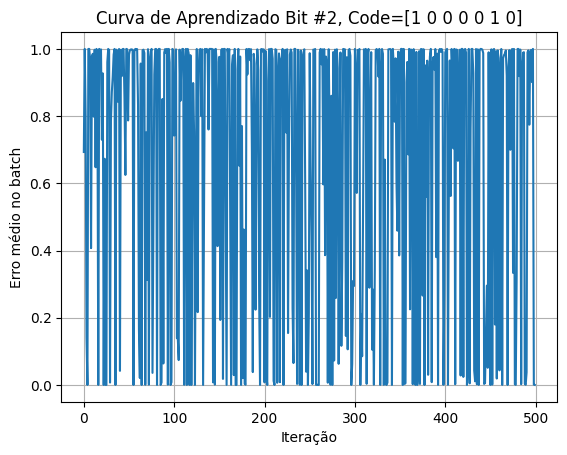

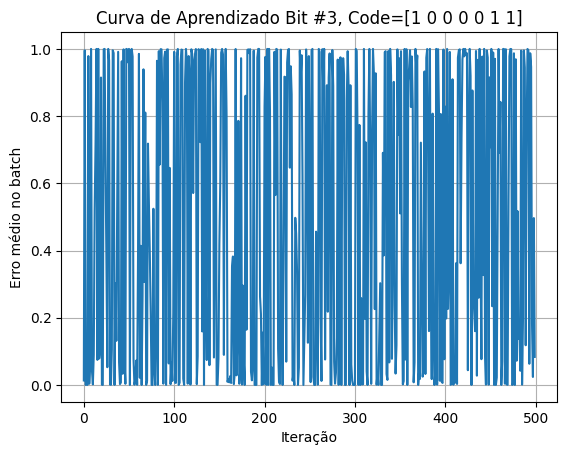

...

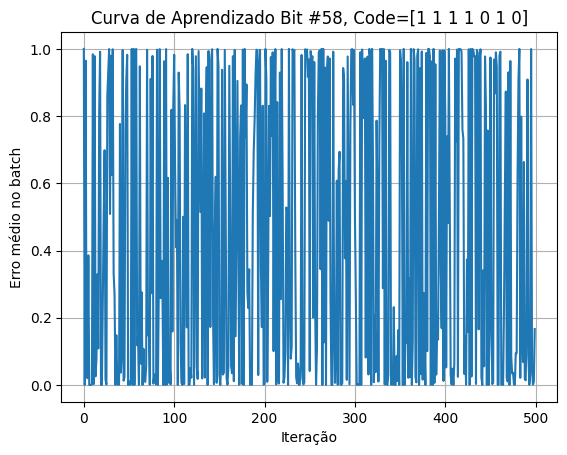

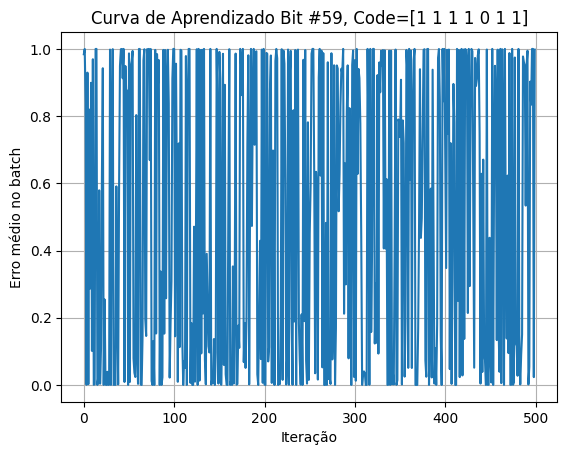

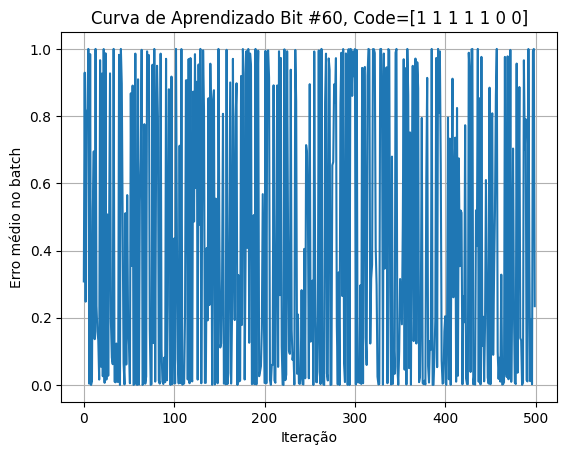

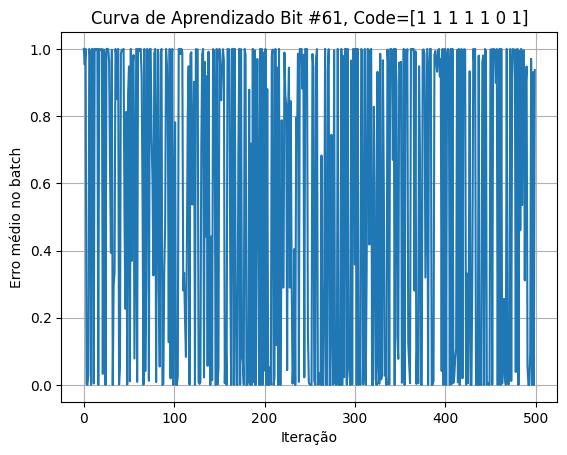

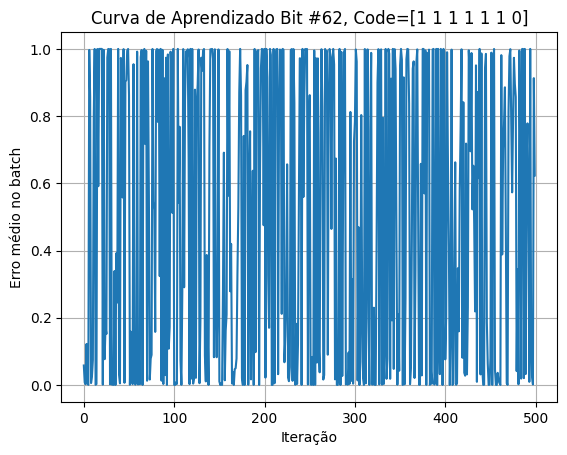

In [15]:
model = CLog_Ecoc(kernel=1, step=0.0001, n_iter=500, batch_size=1, iterative=False, mode='primal')

model.fit(X_train_filtrado, y_train_reindexed)

y_pred_train = model.predict(X_train_filtrado)
acc_train = accuracy_score(y_train_reindexed, y_pred_train)
print(f"Accuracy de treino: {acc_train:.2f}")

y_pred_test = model.predict(X_test_filtrado)
acc_test = accuracy_score(y_test_reindexed, y_pred_test)
print(f"Accuracy de teste: {acc_test:.2f}")

#Matriz de confusão com rótulos originais
cm = confusion_matrix(y_test_reindexed, y_pred_test)

#Mapping das classes de volta para os rótulos originais
xticks_labels = [str(classe) for classe in model.classes_]
yticks_labels = [str(classe) for classe in model.classes_]

plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=xticks_labels, yticklabels=yticks_labels)
plt.xlabel('Predicted (original class)')
plt.ylabel('True (original class)')
plt.title('Confusion Matrix (com classes filtradas e reindexadas)')
plt.show()

# === Curvas de aprendizagem ===
for i, errors in enumerate(model.get_errors()):
    plt.figure()
    plt.plot(errors)
    plt.title(f"Curva de Aprendizado Bit #{i}, Code={model.codes[:, i]}")
    plt.xlabel("Iteração")
    plt.ylabel("Erro médio no batch")
    plt.grid(True)
    plt.show()

    

# Ecoc Dual, Kernel 1, MGB, 1000

Será gerado output codes de tamanho 63 bits para dados com 7 classes diferentes e canônicas.
Gerando modelo para bit #1 do output code...
Gerando modelo para bit #2 do output code...
Gerando modelo para bit #3 do output code...
Gerando modelo para bit #4 do output code...
Gerando modelo para bit #5 do output code...
Gerando modelo para bit #6 do output code...
Gerando modelo para bit #7 do output code...
Gerando modelo para bit #8 do output code...
Gerando modelo para bit #9 do output code...
Gerando modelo para bit #10 do output code...
Gerando modelo para bit #11 do output code...
Gerando modelo para bit #12 do output code...
Gerando modelo para bit #13 do output code...
Gerando modelo para bit #14 do output code...
Gerando modelo para bit #15 do output code...
Gerando modelo para bit #16 do output code...
Gerando modelo para bit #17 do output code...
Gerando modelo para bit #18 do output code...
Gerando modelo para bit #19 do output code...
Gerando modelo para bit #20 do output code

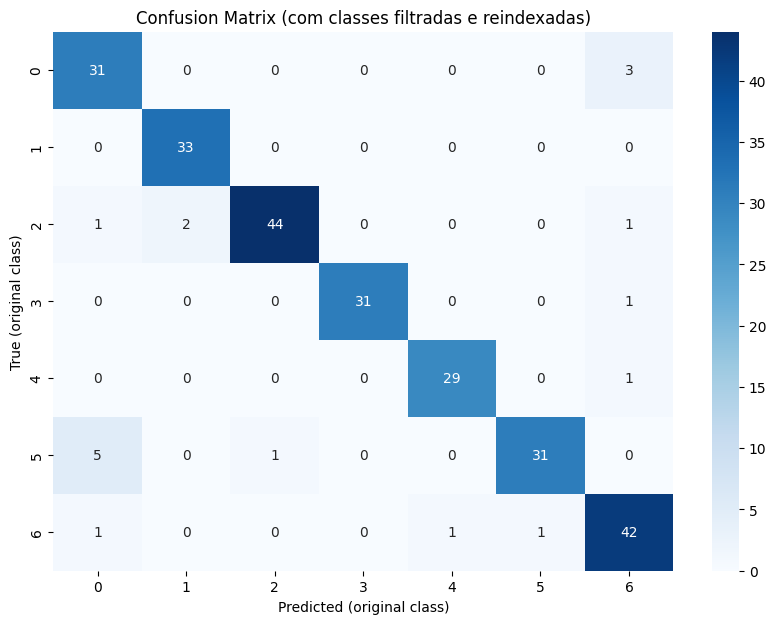

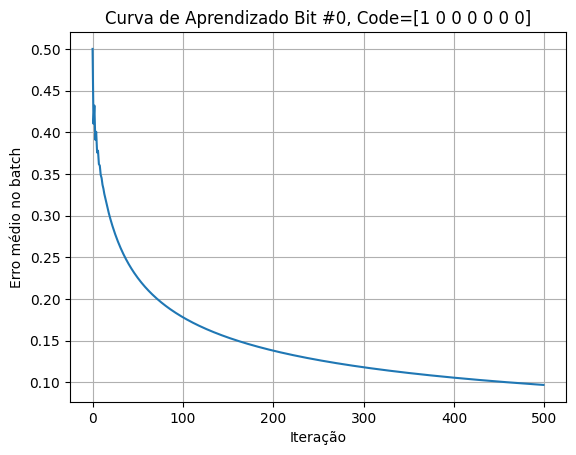

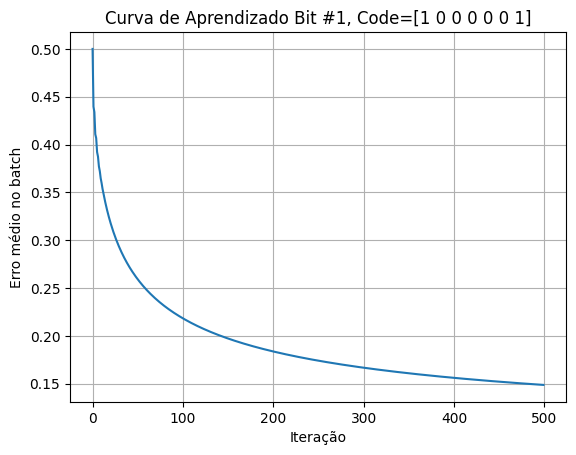

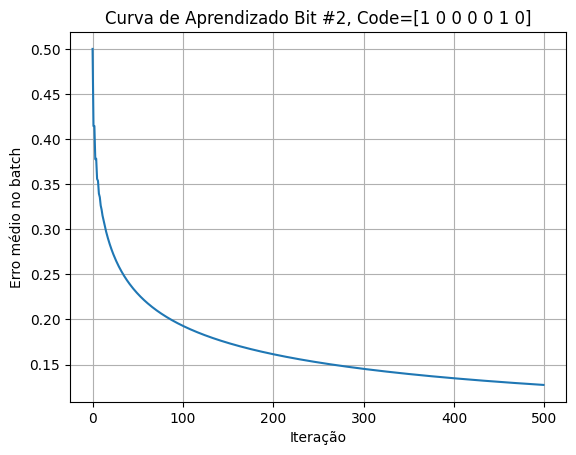

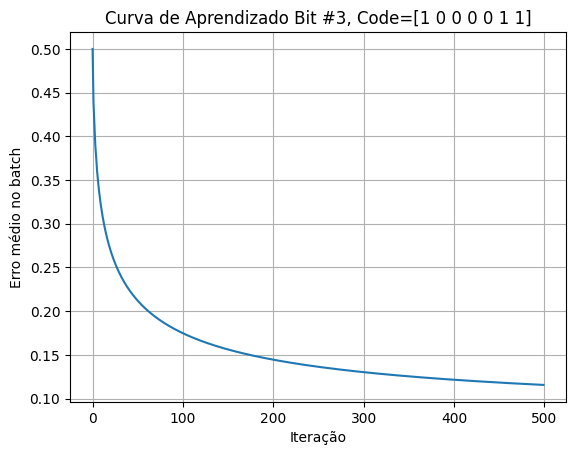

...

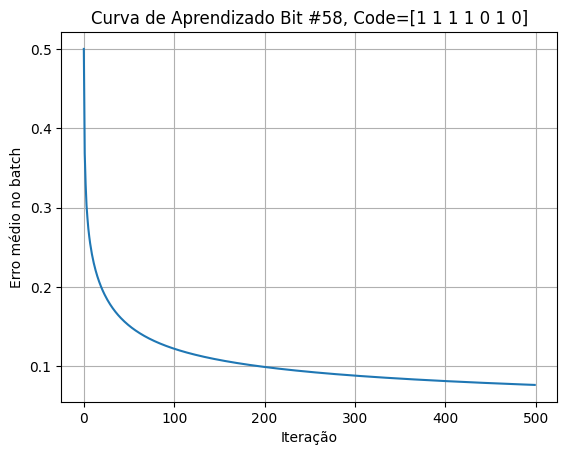

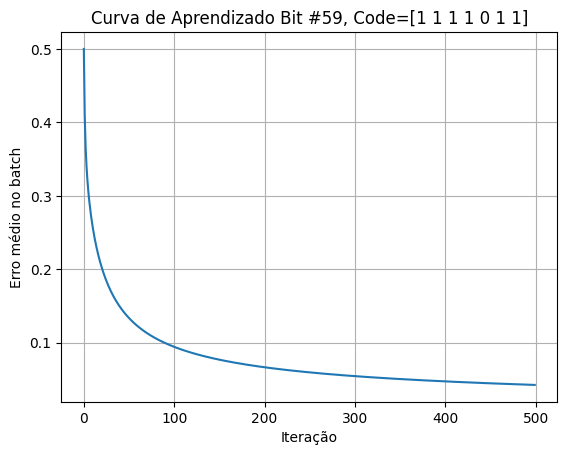

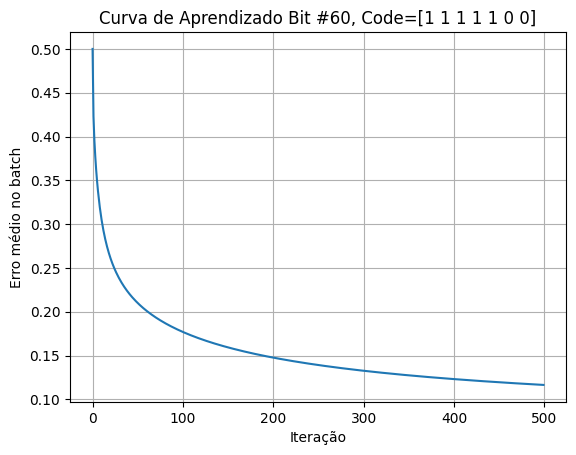

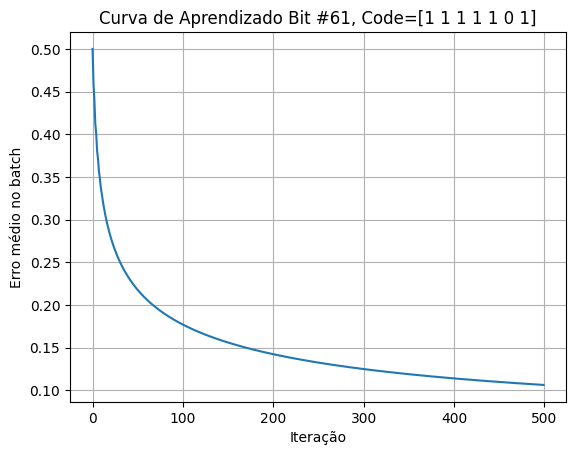

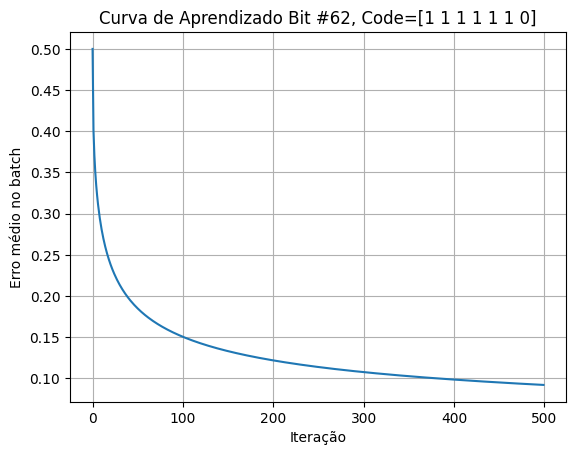

In [16]:
model = CLog_Ecoc(kernel=1, step=0.0001, n_iter=500, batch_size=None, iterative=False, mode='dual')

model.fit(X_train_filtrado, y_train_reindexed)

y_pred_train = model.predict(X_train_filtrado)
acc_train = accuracy_score(y_train_reindexed, y_pred_train)
print(f"Accuracy de treino: {acc_train:.2f}")

y_pred_test = model.predict(X_test_filtrado)
acc_test = accuracy_score(y_test_reindexed, y_pred_test)
print(f"Accuracy de teste: {acc_test:.2f}")

#Matriz de confusão com rótulos originais
cm = confusion_matrix(y_test_reindexed, y_pred_test)

#Mapping das classes de volta para os rótulos originais
xticks_labels = [str(classe) for classe in model.classes_]
yticks_labels = [str(classe) for classe in model.classes_]

plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=xticks_labels, yticklabels=yticks_labels)
plt.xlabel('Predicted (original class)')
plt.ylabel('True (original class)')
plt.title('Confusion Matrix (com classes filtradas e reindexadas)')
plt.show()

# === Curvas de aprendizagem ===
for i, errors in enumerate(model.get_errors()):
    plt.figure()
    plt.plot(errors)
    plt.title(f"Curva de Aprendizado Bit #{i}, Code={model.codes[:, i]}")
    plt.xlabel("Iteração")
    plt.ylabel("Erro médio no batch")
    plt.grid(True)
    plt.show()

    

# Ecoc Dual, Kernel 1, MGmB, 1000

Será gerado output codes de tamanho 63 bits para dados com 7 classes diferentes e canônicas.
Gerando modelo para bit #1 do output code...
Gerando modelo para bit #2 do output code...
Gerando modelo para bit #3 do output code...
Gerando modelo para bit #4 do output code...
Gerando modelo para bit #5 do output code...
Gerando modelo para bit #6 do output code...
Gerando modelo para bit #7 do output code...
Gerando modelo para bit #8 do output code...
Gerando modelo para bit #9 do output code...
Gerando modelo para bit #10 do output code...
Gerando modelo para bit #11 do output code...
Gerando modelo para bit #12 do output code...
Gerando modelo para bit #13 do output code...
Gerando modelo para bit #14 do output code...
Gerando modelo para bit #15 do output code...
Gerando modelo para bit #16 do output code...
Gerando modelo para bit #17 do output code...
Gerando modelo para bit #18 do output code...
Gerando modelo para bit #19 do output code...
Gerando modelo para bit #20 do output code

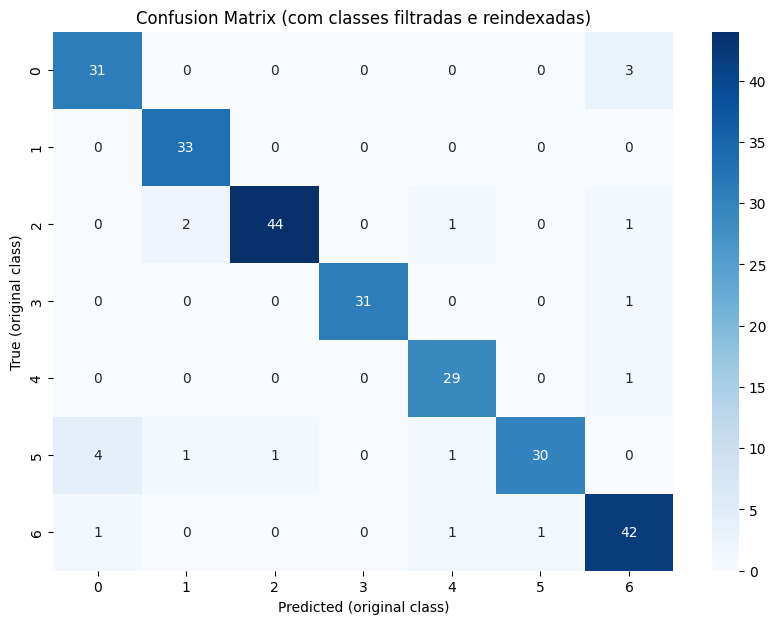

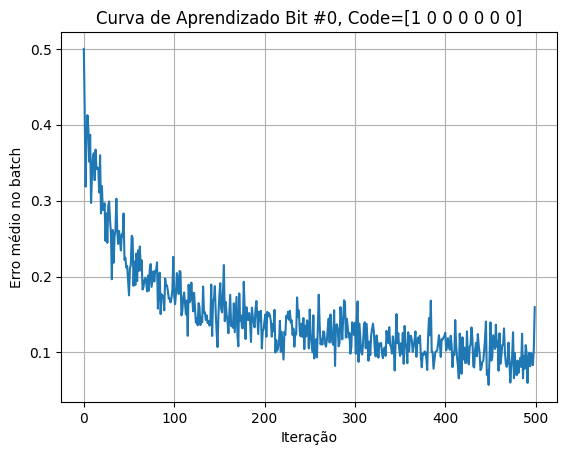

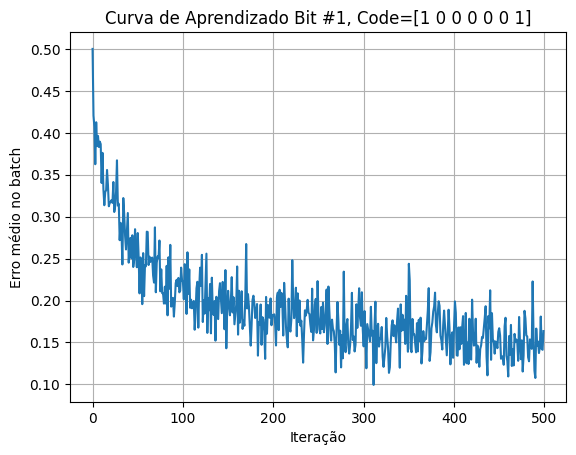

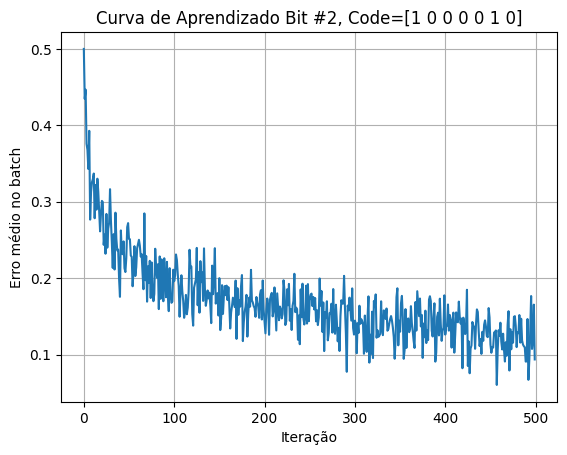

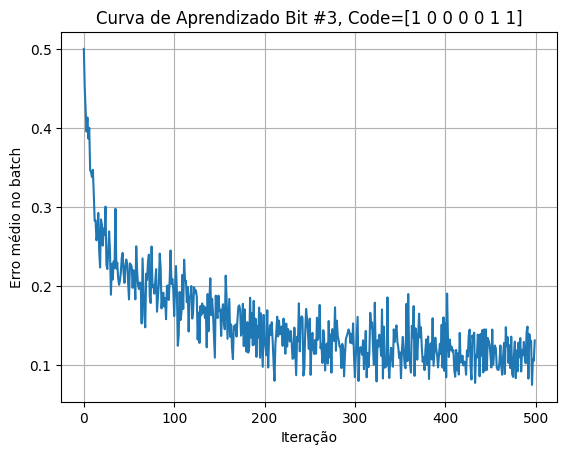

...

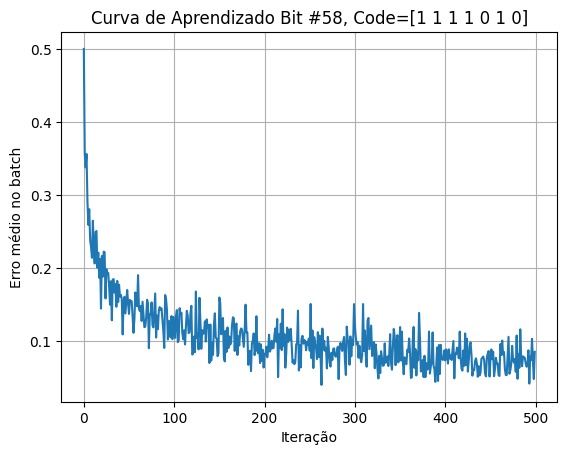

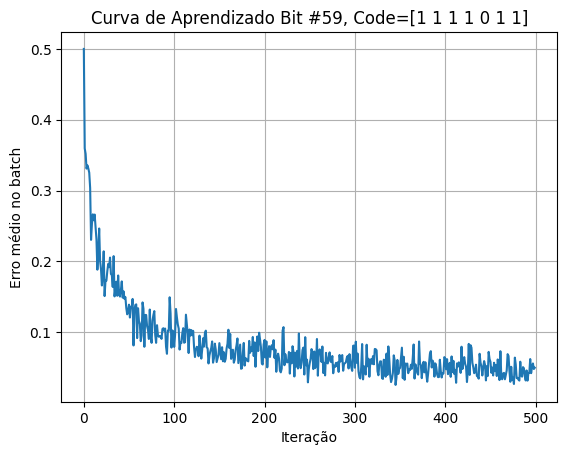

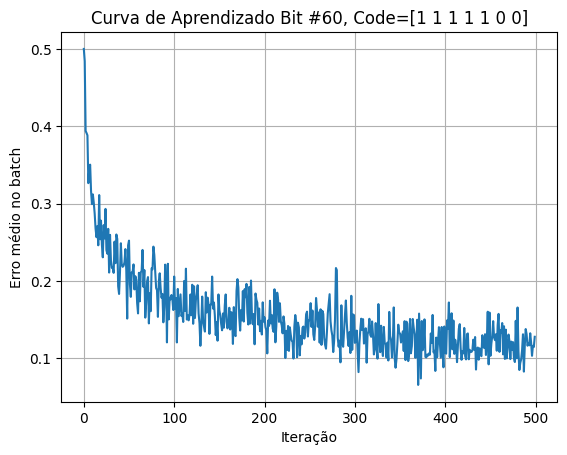

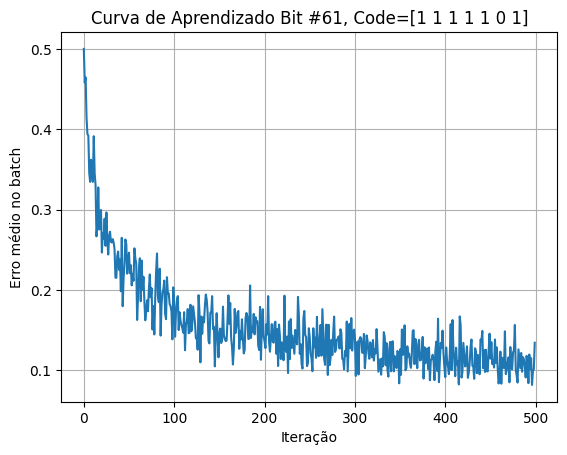

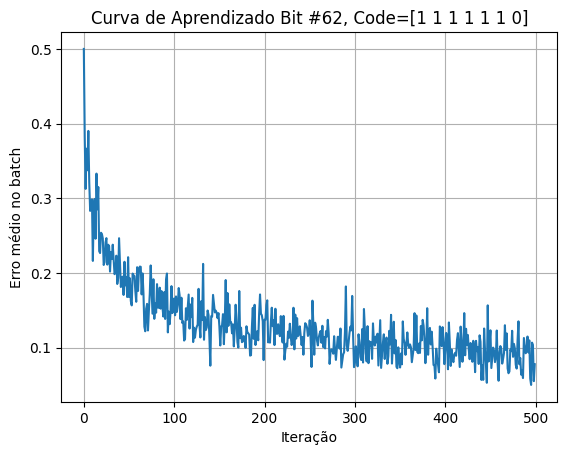

In [17]:
model = CLog_Ecoc(kernel=1, step=0.0001, n_iter=500, batch_size=64, iterative=False, mode='dual')

model.fit(X_train_filtrado, y_train_reindexed)

y_pred_train = model.predict(X_train_filtrado)
acc_train = accuracy_score(y_train_reindexed, y_pred_train)
print(f"Accuracy de treino: {acc_train:.2f}")

y_pred_test = model.predict(X_test_filtrado)
acc_test = accuracy_score(y_test_reindexed, y_pred_test)
print(f"Accuracy de teste: {acc_test:.2f}")

#Matriz de confusão com rótulos originais
cm = confusion_matrix(y_test_reindexed, y_pred_test)

#Mapping das classes de volta para os rótulos originais
xticks_labels = [str(classe) for classe in model.classes_]
yticks_labels = [str(classe) for classe in model.classes_]

plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=xticks_labels, yticklabels=yticks_labels)
plt.xlabel('Predicted (original class)')
plt.ylabel('True (original class)')
plt.title('Confusion Matrix (com classes filtradas e reindexadas)')
plt.show()

# === Curvas de aprendizagem ===
for i, errors in enumerate(model.get_errors()):
    plt.figure()
    plt.plot(errors)
    plt.title(f"Curva de Aprendizado Bit #{i}, Code={model.codes[:, i]}")
    plt.xlabel("Iteração")
    plt.ylabel("Erro médio no batch")
    plt.grid(True)
    plt.show()

    

# Ecoc Dual, Kernel 1, MGE, 1000

Será gerado output codes de tamanho 63 bits para dados com 7 classes diferentes e canônicas.
Gerando modelo para bit #1 do output code...
Gerando modelo para bit #2 do output code...
Gerando modelo para bit #3 do output code...
Gerando modelo para bit #4 do output code...
Gerando modelo para bit #5 do output code...
Gerando modelo para bit #6 do output code...
Gerando modelo para bit #7 do output code...
Gerando modelo para bit #8 do output code...
Gerando modelo para bit #9 do output code...
Gerando modelo para bit #10 do output code...
Gerando modelo para bit #11 do output code...
Gerando modelo para bit #12 do output code...
Gerando modelo para bit #13 do output code...
Gerando modelo para bit #14 do output code...
Gerando modelo para bit #15 do output code...
Gerando modelo para bit #16 do output code...
Gerando modelo para bit #17 do output code...
Gerando modelo para bit #18 do output code...
Gerando modelo para bit #19 do output code...
Gerando modelo para bit #20 do output code

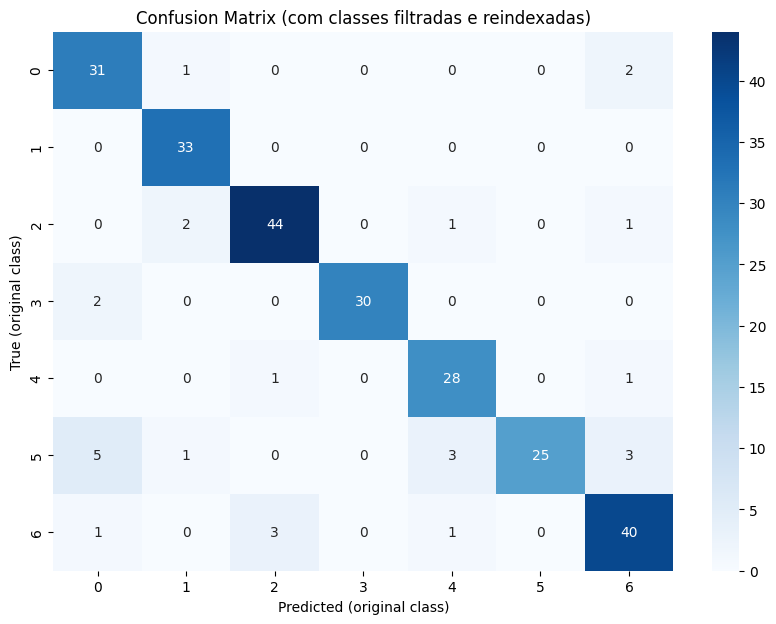

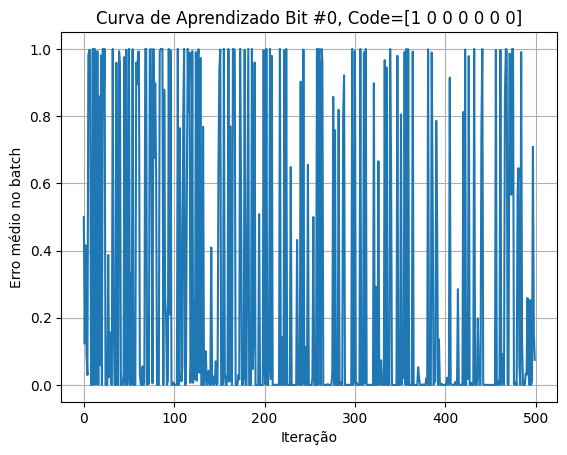

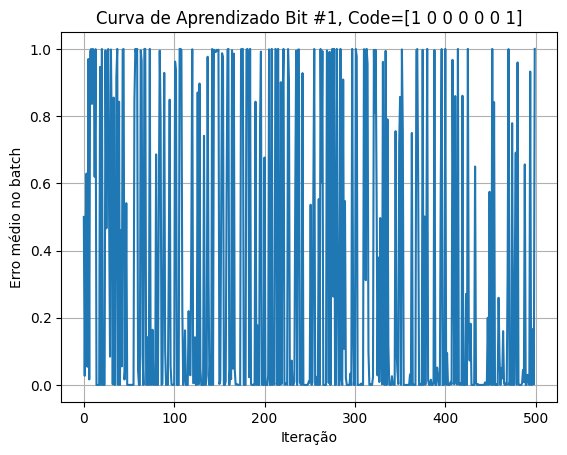

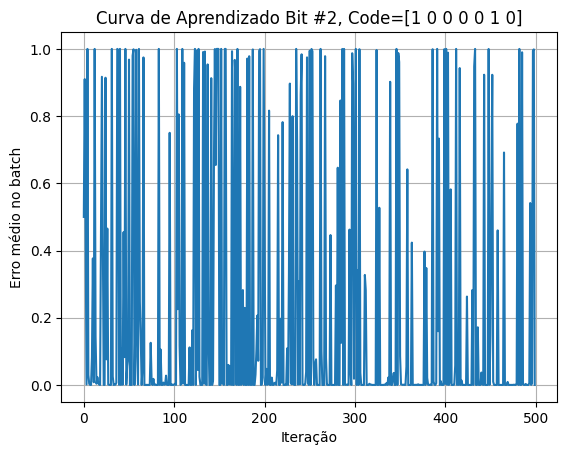

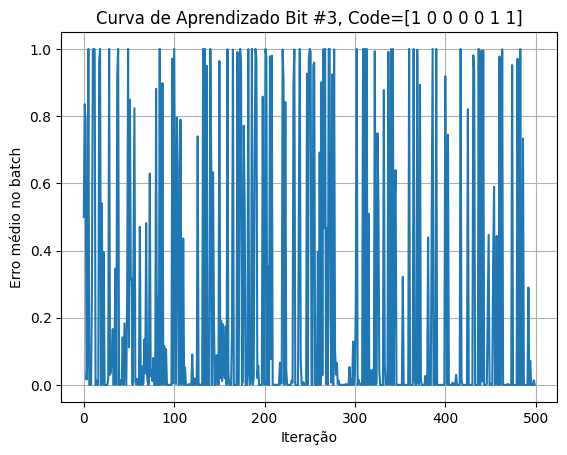

...

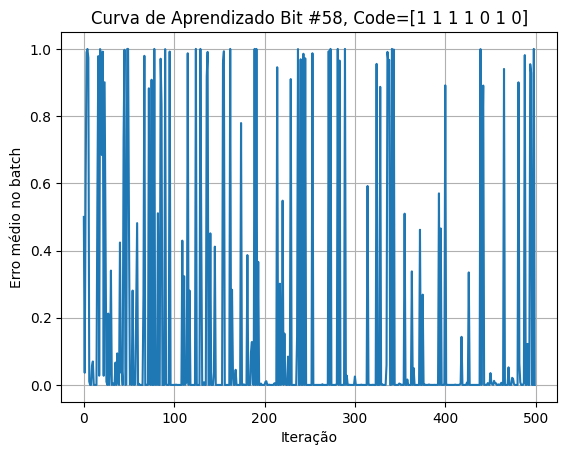

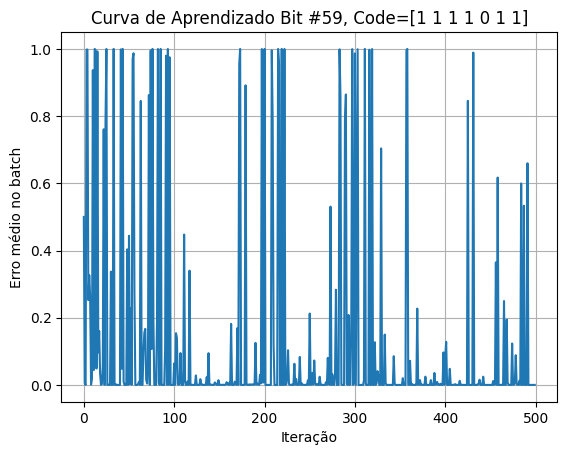

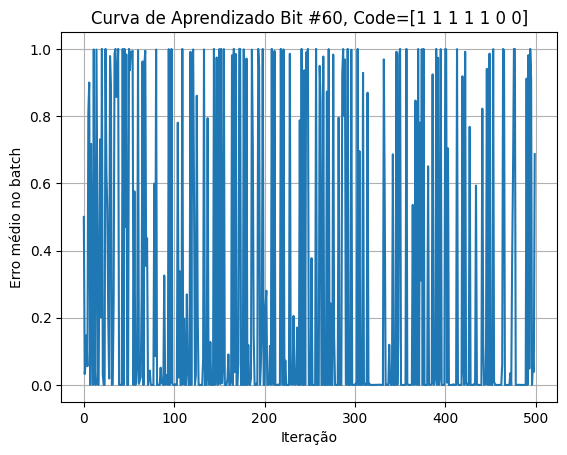

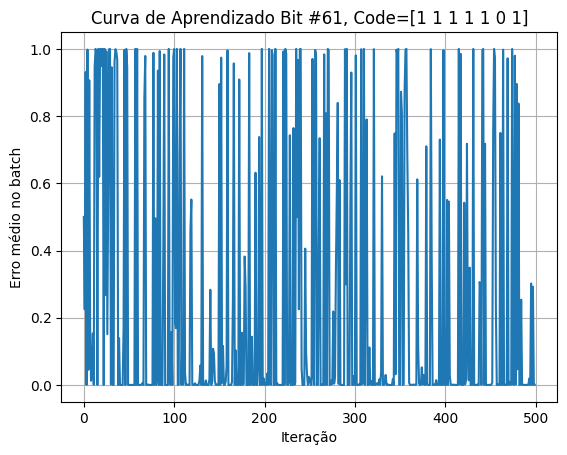

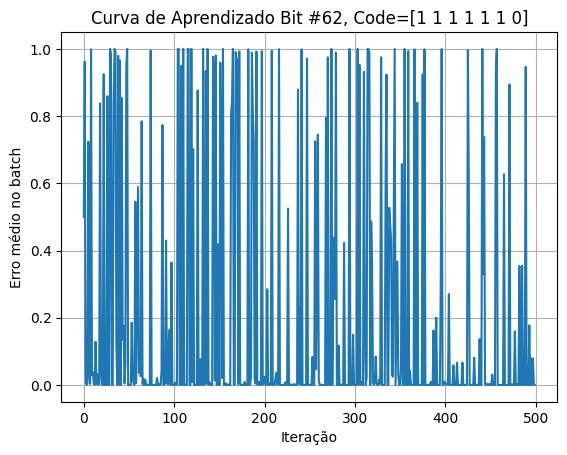

In [18]:
model = CLog_Ecoc(kernel=1, step=0.0001, n_iter=500, batch_size=1, iterative=False, mode='dual')

model.fit(X_train_filtrado, y_train_reindexed)

y_pred_train = model.predict(X_train_filtrado)
acc_train = accuracy_score(y_train_reindexed, y_pred_train)
print(f"Accuracy de treino: {acc_train:.2f}")

y_pred_test = model.predict(X_test_filtrado)
acc_test = accuracy_score(y_test_reindexed, y_pred_test)
print(f"Accuracy de teste: {acc_test:.2f}")

#Matriz de confusão com rótulos originais
cm = confusion_matrix(y_test_reindexed, y_pred_test)

#Mapping das classes de volta para os rótulos originais
xticks_labels = [str(classe) for classe in model.classes_]
yticks_labels = [str(classe) for classe in model.classes_]

plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=xticks_labels, yticklabels=yticks_labels)
plt.xlabel('Predicted (original class)')
plt.ylabel('True (original class)')
plt.title('Confusion Matrix (com classes filtradas e reindexadas)')
plt.show()

# === Curvas de aprendizagem ===
for i, errors in enumerate(model.get_errors()):
    plt.figure()
    plt.plot(errors)
    plt.title(f"Curva de Aprendizado Bit #{i}, Code={model.codes[:, i]}")
    plt.xlabel("Iteração")
    plt.ylabel("Erro médio no batch")
    plt.grid(True)
    plt.show()

    

# Ecoc Dual, Kernel 2, MGB, 1000

Será gerado output codes de tamanho 63 bits para dados com 7 classes diferentes e canônicas.
Gerando modelo para bit #1 do output code...


c:\Users\conta\Desktop\Stuff\Universidade\OML\Projeto-OML\CLogDKPd_MGmB.py:40: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-x))


Gerando modelo para bit #2 do output code...
Gerando modelo para bit #3 do output code...
Gerando modelo para bit #4 do output code...
Gerando modelo para bit #5 do output code...
Gerando modelo para bit #6 do output code...
Gerando modelo para bit #7 do output code...
Gerando modelo para bit #8 do output code...
Gerando modelo para bit #9 do output code...
Gerando modelo para bit #10 do output code...
Gerando modelo para bit #11 do output code...
Gerando modelo para bit #12 do output code...
Gerando modelo para bit #13 do output code...
Gerando modelo para bit #14 do output code...
Gerando modelo para bit #15 do output code...
Gerando modelo para bit #16 do output code...
Gerando modelo para bit #17 do output code...
Gerando modelo para bit #18 do output code...
Gerando modelo para bit #19 do output code...
Gerando modelo para bit #20 do output code...
Gerando modelo para bit #21 do output code...
Gerando modelo para bit #22 do output code...
Gerando modelo para bit #23 do output code

c:\Users\conta\Desktop\Stuff\Universidade\OML\Projeto-OML\CLogDKPd_MGmB.py:40: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-x))


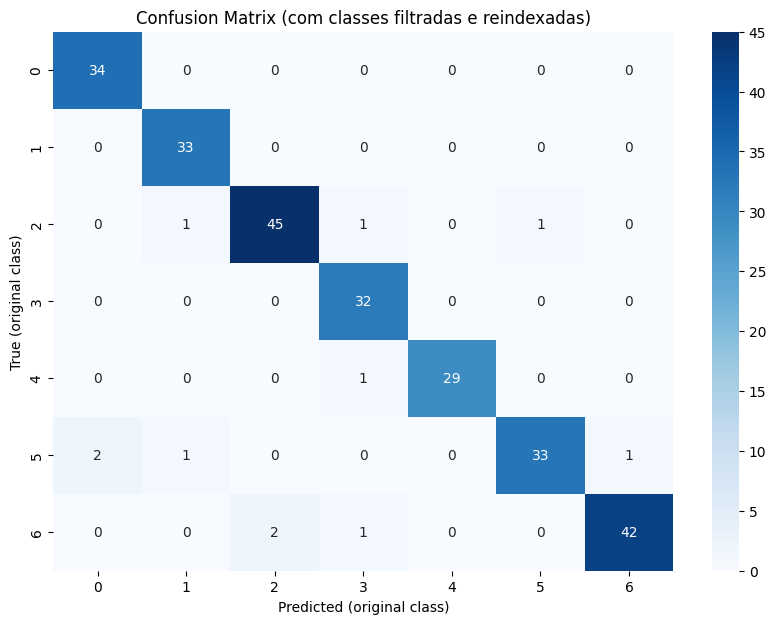

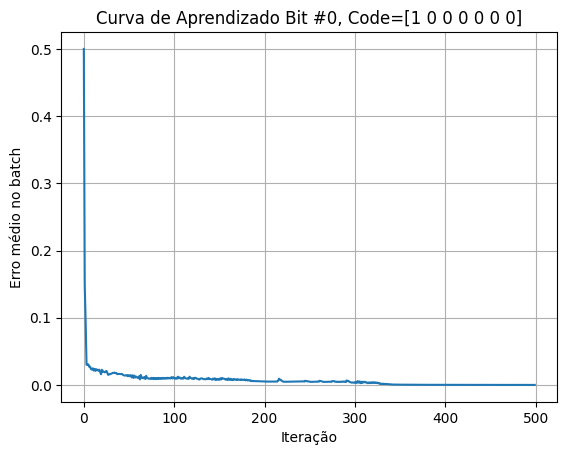

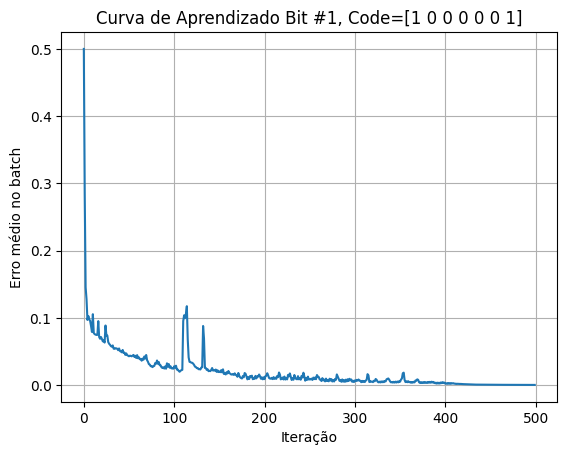

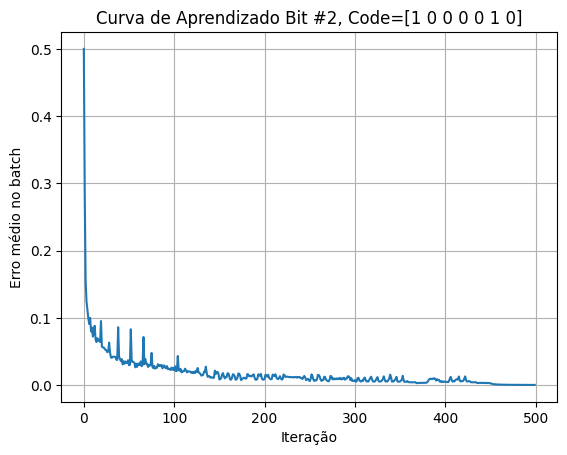

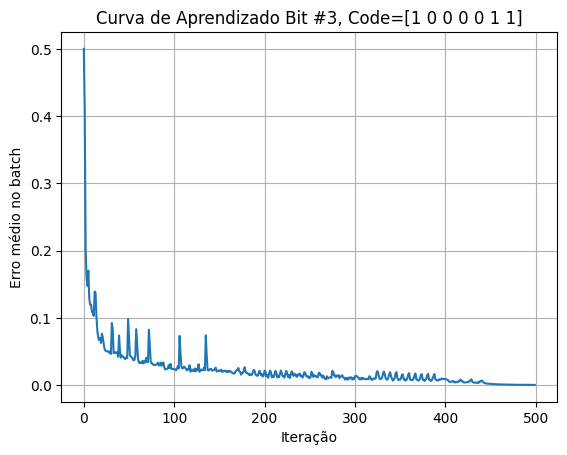

...

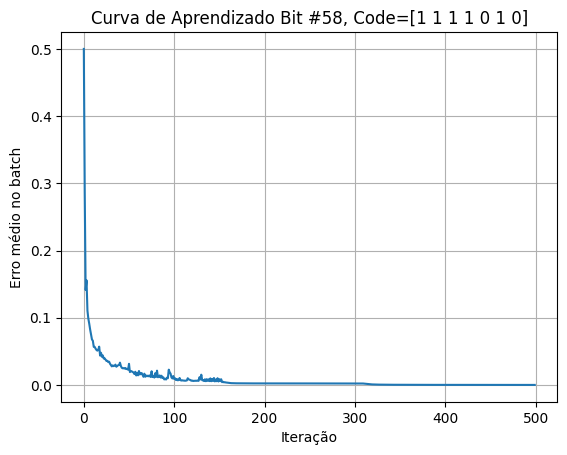

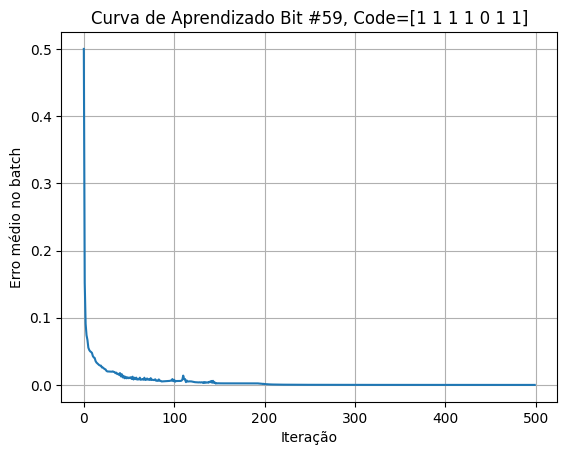

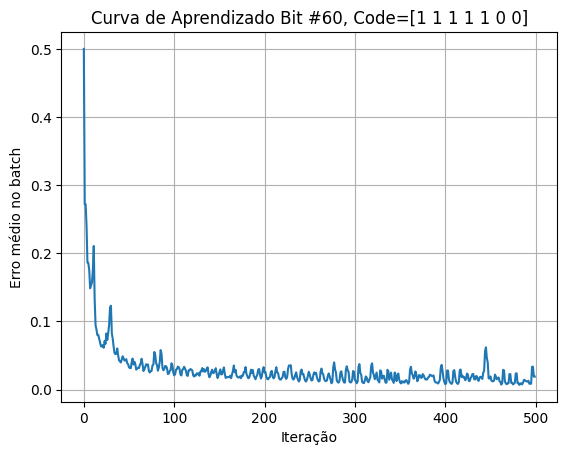

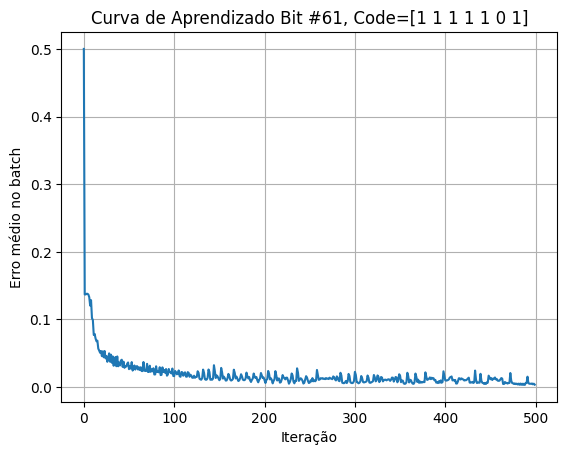

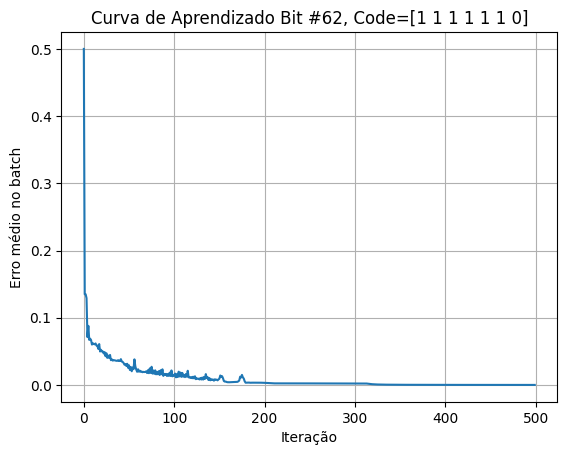

In [19]:
model = CLog_Ecoc(kernel=2, step=0.0001, n_iter=500, batch_size=None, iterative=False, mode='dual')

model.fit(X_train_filtrado, y_train_reindexed)

y_pred_train = model.predict(X_train_filtrado)
acc_train = accuracy_score(y_train_reindexed, y_pred_train)
print(f"Accuracy de treino: {acc_train:.2f}")

y_pred_test = model.predict(X_test_filtrado)
acc_test = accuracy_score(y_test_reindexed, y_pred_test)
print(f"Accuracy de teste: {acc_test:.2f}")

#Matriz de confusão com rótulos originais
cm = confusion_matrix(y_test_reindexed, y_pred_test)

#Mapping das classes de volta para os rótulos originais
xticks_labels = [str(classe) for classe in model.classes_]
yticks_labels = [str(classe) for classe in model.classes_]

plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=xticks_labels, yticklabels=yticks_labels)
plt.xlabel('Predicted (original class)')
plt.ylabel('True (original class)')
plt.title('Confusion Matrix (com classes filtradas e reindexadas)')
plt.show()

# === Curvas de aprendizagem ===
for i, errors in enumerate(model.get_errors()):
    plt.figure()
    plt.plot(errors)
    plt.title(f"Curva de Aprendizado Bit #{i}, Code={model.codes[:, i]}")
    plt.xlabel("Iteração")
    plt.ylabel("Erro médio no batch")
    plt.grid(True)
    plt.show()

    

# Ecoc Dual, Kernel 2, MGmB, 1000

Será gerado output codes de tamanho 63 bits para dados com 7 classes diferentes e canônicas.
Gerando modelo para bit #1 do output code...
Gerando modelo para bit #2 do output code...
Gerando modelo para bit #3 do output code...


c:\Users\conta\Desktop\Stuff\Universidade\OML\Projeto-OML\CLogDKPd_MGmB.py:40: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-x))


Gerando modelo para bit #4 do output code...
Gerando modelo para bit #5 do output code...
Gerando modelo para bit #6 do output code...
Gerando modelo para bit #7 do output code...
Gerando modelo para bit #8 do output code...
Gerando modelo para bit #9 do output code...
Gerando modelo para bit #10 do output code...
Gerando modelo para bit #11 do output code...
Gerando modelo para bit #12 do output code...
Gerando modelo para bit #13 do output code...
Gerando modelo para bit #14 do output code...
Gerando modelo para bit #15 do output code...
Gerando modelo para bit #16 do output code...
Gerando modelo para bit #17 do output code...
Gerando modelo para bit #18 do output code...
Gerando modelo para bit #19 do output code...
Gerando modelo para bit #20 do output code...
Gerando modelo para bit #21 do output code...
Gerando modelo para bit #22 do output code...
Gerando modelo para bit #23 do output code...
Gerando modelo para bit #24 do output code...
Gerando modelo para bit #25 do output co

c:\Users\conta\Desktop\Stuff\Universidade\OML\Projeto-OML\CLogDKPd_MGmB.py:40: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-x))


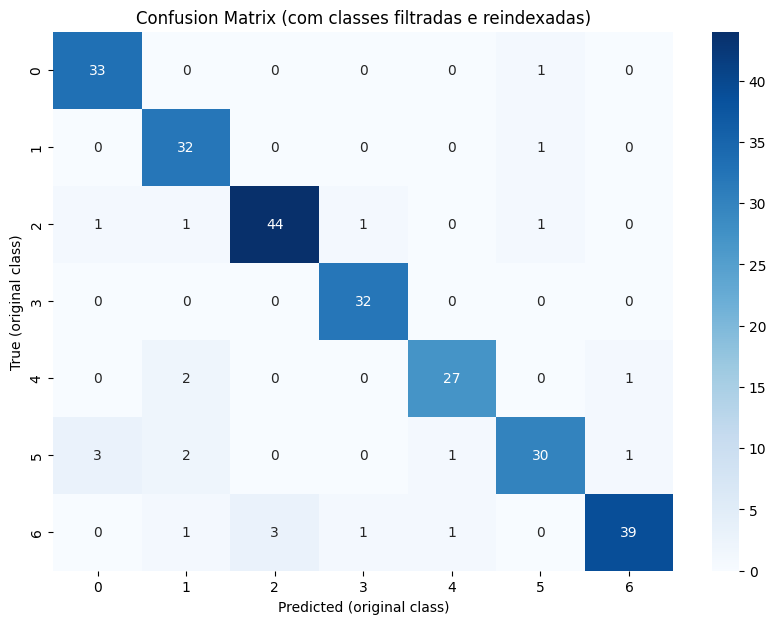

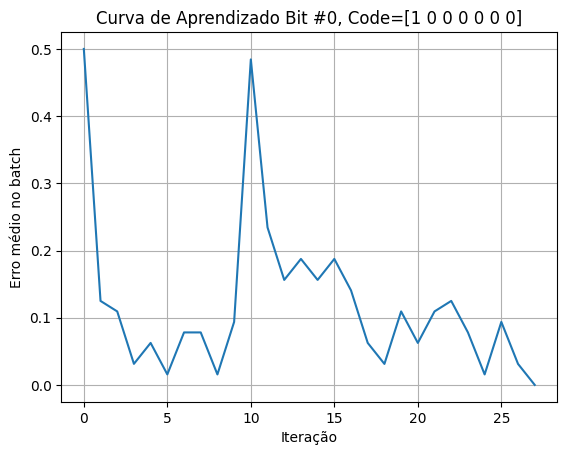

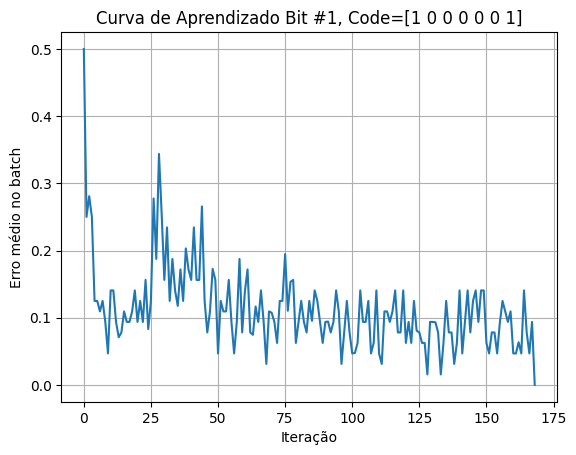

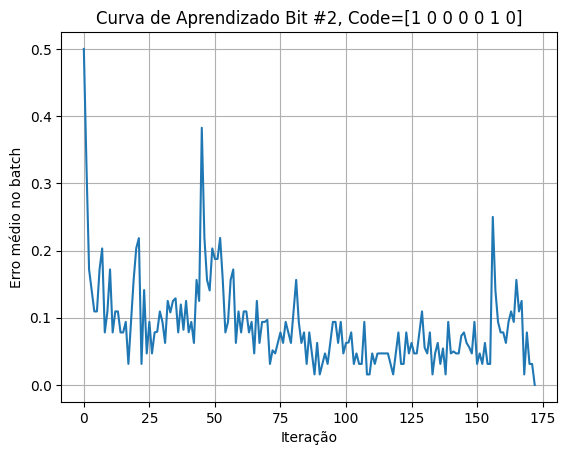

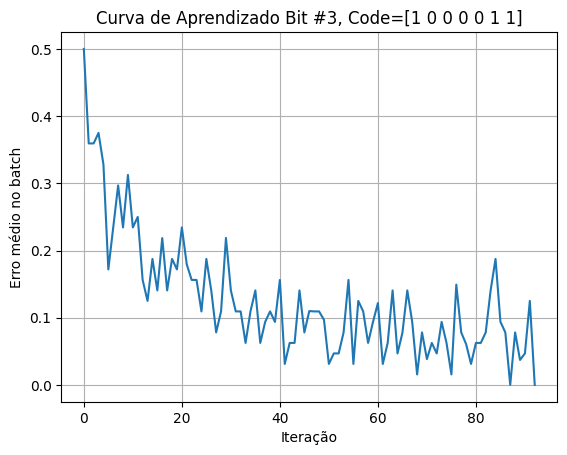

...

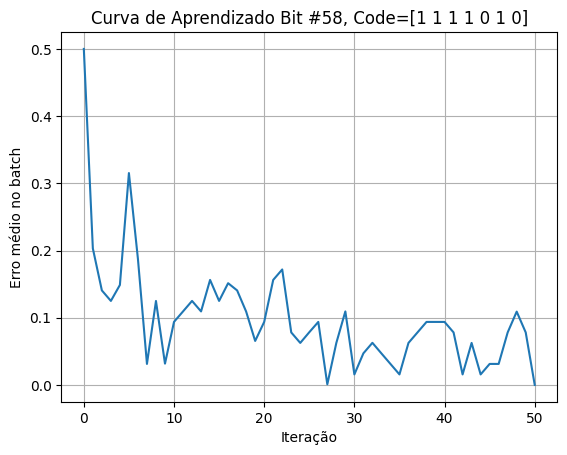

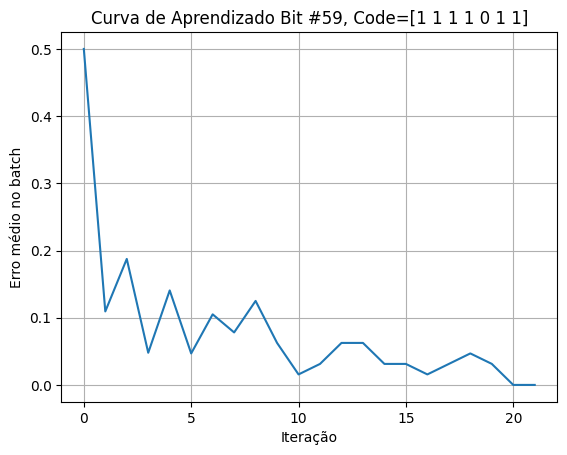

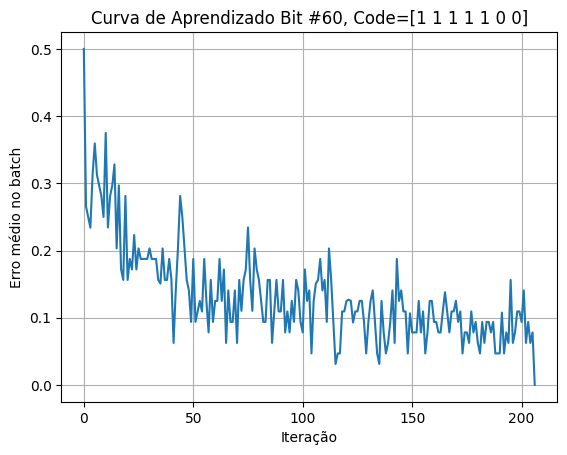

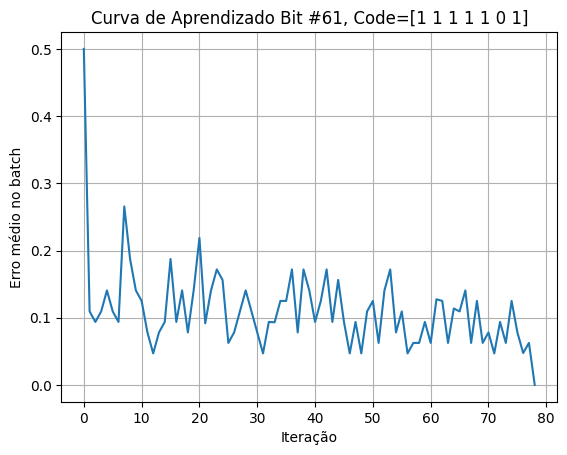

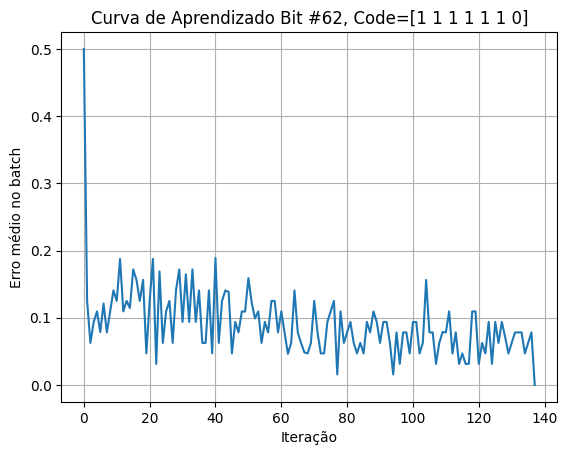

In [23]:
model = CLog_Ecoc(kernel=2, step=0.0001, n_iter=500, batch_size=64, iterative=False, mode='dual')

model.fit(X_train_filtrado, y_train_reindexed)

y_pred_train = model.predict(X_train_filtrado)
acc_train = accuracy_score(y_train_reindexed, y_pred_train)
print(f"Accuracy de treino: {acc_train:.2f}")

y_pred_test = model.predict(X_test_filtrado)
acc_test = accuracy_score(y_test_reindexed, y_pred_test)
print(f"Accuracy de teste: {acc_test:.2f}")

#Matriz de confusão com rótulos originais
cm = confusion_matrix(y_test_reindexed, y_pred_test)

#Mapping das classes de volta para os rótulos originais
xticks_labels = [str(classe) for classe in model.classes_]
yticks_labels = [str(classe) for classe in model.classes_]

plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=xticks_labels, yticklabels=yticks_labels)
plt.xlabel('Predicted (original class)')
plt.ylabel('True (original class)')
plt.title('Confusion Matrix (com classes filtradas e reindexadas)')
plt.show()

# === Curvas de aprendizagem ===
for i, errors in enumerate(model.get_errors()):
    plt.figure()
    plt.plot(errors)
    plt.title(f"Curva de Aprendizado Bit #{i}, Code={model.codes[:, i]}")
    plt.xlabel("Iteração")
    plt.ylabel("Erro médio no batch")
    plt.grid(True)
    plt.show()

    

# Ecoc Dual,Kernel 2, MGE, 1000

Será gerado output codes de tamanho 63 bits para dados com 7 classes diferentes e canônicas.
Gerando modelo para bit #1 do output code...
Gerando modelo para bit #2 do output code...
Gerando modelo para bit #3 do output code...
Gerando modelo para bit #4 do output code...
Gerando modelo para bit #5 do output code...


c:\Users\conta\Desktop\Stuff\Universidade\OML\Projeto-OML\CLogDKPd_MGmB.py:40: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-x))


Gerando modelo para bit #6 do output code...
Gerando modelo para bit #7 do output code...
Gerando modelo para bit #8 do output code...
Gerando modelo para bit #9 do output code...
Gerando modelo para bit #10 do output code...
Gerando modelo para bit #11 do output code...
Gerando modelo para bit #12 do output code...
Gerando modelo para bit #13 do output code...
Gerando modelo para bit #14 do output code...
Gerando modelo para bit #15 do output code...
Gerando modelo para bit #16 do output code...
Gerando modelo para bit #17 do output code...
Gerando modelo para bit #18 do output code...
Gerando modelo para bit #19 do output code...
Gerando modelo para bit #20 do output code...
Gerando modelo para bit #21 do output code...
Gerando modelo para bit #22 do output code...
Gerando modelo para bit #23 do output code...
Gerando modelo para bit #24 do output code...
Gerando modelo para bit #25 do output code...
Gerando modelo para bit #26 do output code...
Gerando modelo para bit #27 do output 

c:\Users\conta\Desktop\Stuff\Universidade\OML\Projeto-OML\CLogDKPd_MGmB.py:40: RuntimeWarning: overflow encountered in exp
  return 1 / (1 + np.exp(-x))


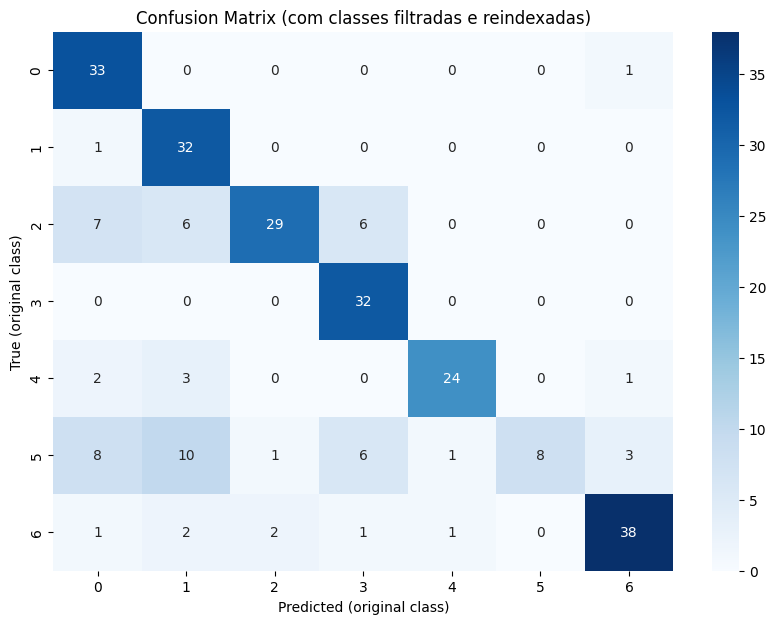

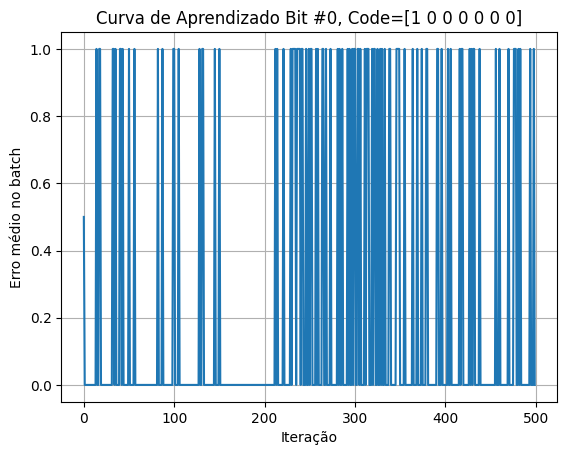

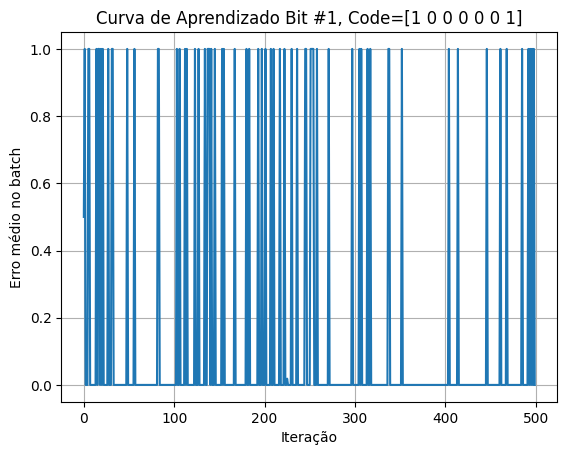

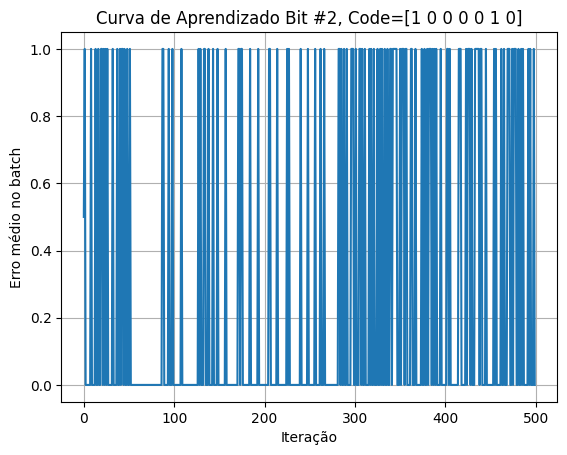

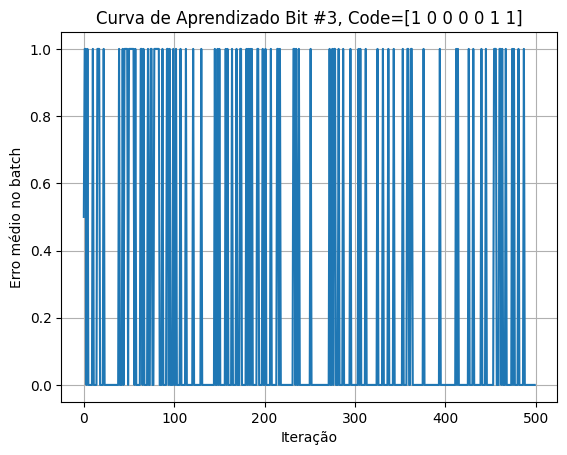

...

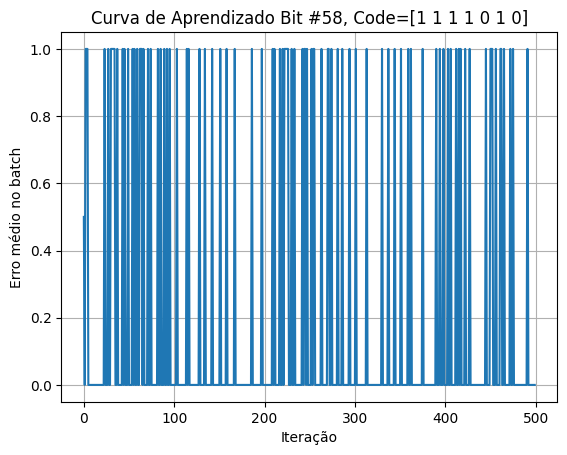

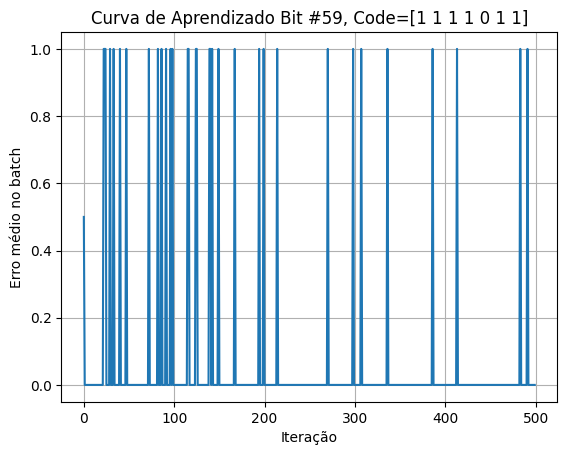

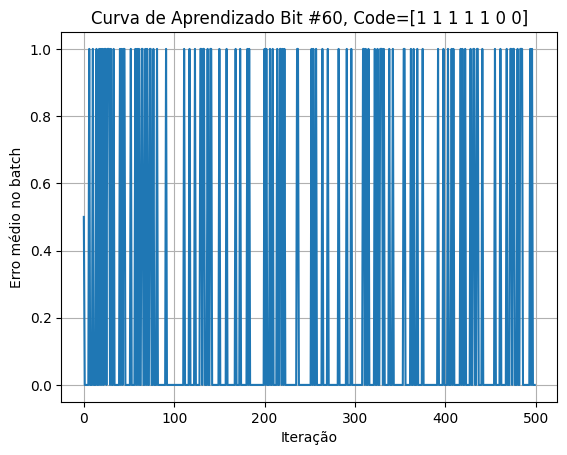

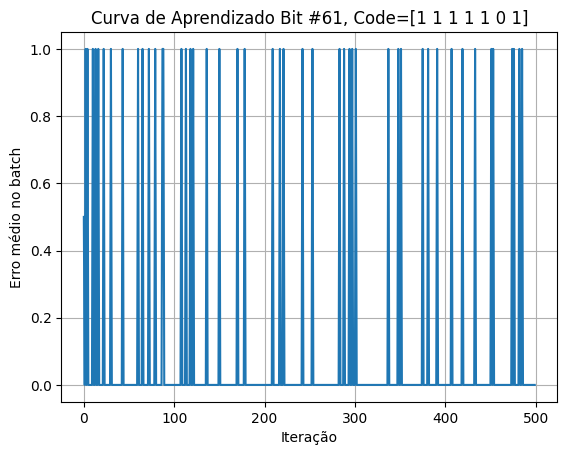

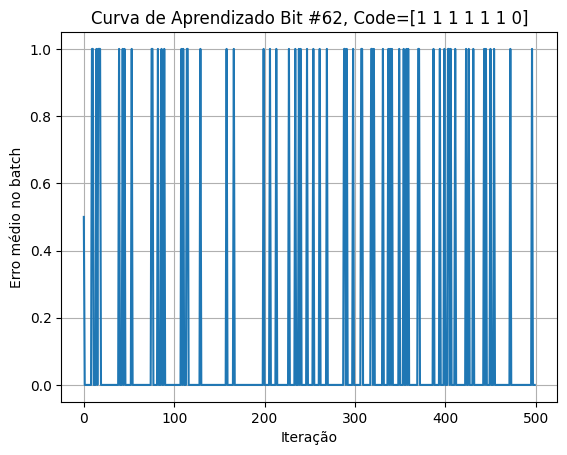

In [24]:
model = CLog_Ecoc(kernel=2, step=0.0001, n_iter=500, batch_size=1, iterative=False, mode='dual')

model.fit(X_train_filtrado, y_train_reindexed)

y_pred_train = model.predict(X_train_filtrado)
acc_train = accuracy_score(y_train_reindexed, y_pred_train)
print(f"Accuracy de treino: {acc_train:.2f}")

y_pred_test = model.predict(X_test_filtrado)
acc_test = accuracy_score(y_test_reindexed, y_pred_test)
print(f"Accuracy de teste: {acc_test:.2f}")

#Matriz de confusão com rótulos originais
cm = confusion_matrix(y_test_reindexed, y_pred_test)

#Mapping das classes de volta para os rótulos originais
xticks_labels = [str(classe) for classe in model.classes_]
yticks_labels = [str(classe) for classe in model.classes_]

plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=xticks_labels, yticklabels=yticks_labels)
plt.xlabel('Predicted (original class)')
plt.ylabel('True (original class)')
plt.title('Confusion Matrix (com classes filtradas e reindexadas)')
plt.show()

# === Curvas de aprendizagem ===
for i, errors in enumerate(model.get_errors()):
    plt.figure()
    plt.plot(errors)
    plt.title(f"Curva de Aprendizado Bit #{i}, Code={model.codes[:, i]}")
    plt.xlabel("Iteração")
    plt.ylabel("Erro médio no batch")
    plt.grid(True)
    plt.show()

    